In [ ]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

# **Import libraries**

for Read dicom images

In [ ]:
pip install pydicom 


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 40.4 MB/s eta 0:00:00


In [ ]:
pip install SimpleITK

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 16.0 MB/s eta 0:00:00


In [ ]:
# visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import pydicom
import pydicom as dicom
from skimage import io
import os

# handle table-like data and matrices
import pandas as pd
import numpy as np
import glob
import random
import tensorflow.keras.backend as kb

# ignore warnings
import warnings
warnings.filterwarnings('ignore')

# model
from keras import backend as K
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras.layers import *
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.utils import plot_model
from tensorflow.keras import Model
from tensorflow.keras.models import load_model, save_model

# Bring in the sequential api for the generator and discriminator
from tensorflow.keras.models import Sequential

# Bring in the layers for the neural network
from tensorflow.keras.layers import Conv2D, Dense, Flatten, Reshape, LeakyReLU, Dropout, UpSampling2D

from tqdm import tqdm
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, Conv2D, Reshape, Input, Conv2DTranspose
from keras.layers import Activation, LeakyReLU, BatchNormalization, Dropout, Resizing
from keras.losses import BinaryCrossentropy
from tensorflow.keras.applications import VGG16
try:
    from tensorflow.keras.optimizers import Adam
except:
    from keras.optimizers import Adam

# import necessary packages
import time
import glob
import matplotlib
import matplotlib.image as mpimg
matplotlib.use('Agg')
%matplotlib inline
import PIL
import imageio

import SimpleITK as sitk
from IPython import display
from IPython.display import Image
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from PIL import Image
from tensorflow.keras.optimizers import Adam
from matplotlib import *
from matplotlib import pyplot
from matplotlib.pyplot import *
import sys
from skimage import metrics
from skimage.metrics import structural_similarity as ssim

Content My Drive

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


# **Convert Data From Dicom To Png**

In [ ]:
dicom_folder = input('input path')
print(dicom_folder)
png_folder = input('output path')
print(png_folder)

for filename in os.listdir(dicom_folder):
    
    if filename.endswith('.dcm'):
        ds = pydicom.dcmread(os.path.join(dicom_folder, filename))
        img = Image.fromarray(ds.pixel_array)
        png_filename = os.path.splitext(filename)[0] + '.png'
        img.save(os.path.join(png_folder, png_filename))


# **dealing with data**

Read Data From Drive

In [ ]:
Patients_Directory_Path = "/content/drive/MyDrive/Total_Clean_Data_png(3)"
Patients_Directory = os.listdir(Patients_Directory_Path)
Patients_Directory.sort()
print(Patients_Directory)

['1', '10', '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '11', '110', '111', '112', '113', '114', '115', '116', '117', '118', '119', '12', '120', '121', '122', '123', '124', '125', '126', '127', '128', '129', '13', '130', '131', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '4', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '5', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '6', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '7', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '8', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '9', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99']


Splitting data

In [ ]:
train_ratio=1

In [ ]:
random.seed(1)

train_patients = random.sample(Patients_Directory, int(len(Patients_Directory)*train_ratio))


 **Training Dataset**

In [ ]:
train_images = []

for patient in train_patients:
    patient_path = os.path.join(Patients_Directory_Path, patient)
    print(patient_path)
    for filename in os.listdir(patient_path):
        f_path = os.path.join(patient_path, filename)
        train_images.append(f_path)
       


/content/drive/MyDrive/Total_Clean_Data_png(3)/13
/content/drive/MyDrive/Total_Clean_Data_png(3)/113
/content/drive/MyDrive/Total_Clean_Data_png(3)/4
/content/drive/MyDrive/Total_Clean_Data_png(3)/126
/content/drive/MyDrive/Total_Clean_Data_png(3)/38
/content/drive/MyDrive/Total_Clean_Data_png(3)/69
/content/drive/MyDrive/Total_Clean_Data_png(3)/32
/content/drive/MyDrive/Total_Clean_Data_png(3)/35
/content/drive/MyDrive/Total_Clean_Data_png(3)/56
/content/drive/MyDrive/Total_Clean_Data_png(3)/24
/content/drive/MyDrive/Total_Clean_Data_png(3)/71
/content/drive/MyDrive/Total_Clean_Data_png(3)/122
/content/drive/MyDrive/Total_Clean_Data_png(3)/11
/content/drive/MyDrive/Total_Clean_Data_png(3)/37
/content/drive/MyDrive/Total_Clean_Data_png(3)/101
/content/drive/MyDrive/Total_Clean_Data_png(3)/84
/content/drive/MyDrive/Total_Clean_Data_png(3)/77
/content/drive/MyDrive/Total_Clean_Data_png(3)/25
/content/drive/MyDrive/Total_Clean_Data_png(3)/30
/content/drive/MyDrive/Total_Clean_Data_png(3)/

check Training Data

In [ ]:
print(len(train_images))

606


convert to a Numpy array

In [ ]:
train_size = len(train_images)
training_images=np.array([np.array(Image.open(i),dtype="float32") for i in train_images[0:train_size]])
print('training images',training_images.shape)

training images (606, 256, 256)


# **Preprocessing**

Normalize pixel values

In [ ]:
training_images = (training_images - 127.5 ) / 127.5

In [ ]:
print(training_images[0][8])

[-1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -1.         -1.         -1.         -1.         -1.         -1.
 -0.99215686 -0.99215686 -0.99215686 -0.99215686 -0.99215686 -0.9843137
 -0.9843137  -0.98

Make into 4D array

In [ ]:
training_images=training_images[:,:,:,np.newaxis]

Check shape

In [ ]:
print(training_images.shape)

(606, 256, 256, 1)


# **Check the brain images**

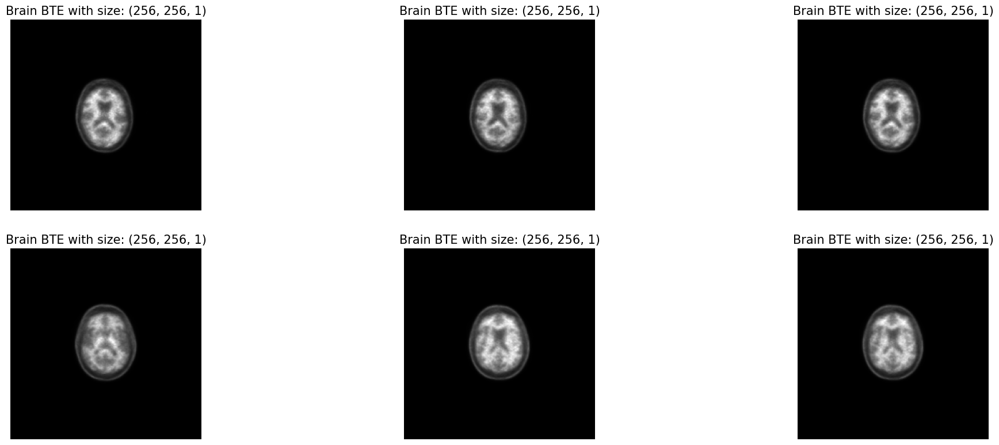

In [ ]:
#Check the brains, plot the first 6
pyplot.figure(figsize=(25,25))
for i in range(6):
    pyplot.subplot(5, 3, 1 + i)
    pyplot.axis('off')
    pyplot.title('Brain BTE with size: {}'.format(training_images[0].shape),fontsize=15)
    pyplot.imshow(training_images[i,:,:,0],cmap='gray')
pyplot.show()


# **Build Generator and discriminator**

In [ ]:
def Generator():

    model = tf.keras.Sequential()

    model.add(Dense(32*32*256, input_shape=(256,)))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((32, 32,256)))

    model.add(Conv2DTranspose(256, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    
    
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    
    
    model.add(Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    

    model.add(Conv2D(64, (3,3), strides=(1,1), padding='same', use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))


    model.add(Conv2D(1, (3,3),strides=(1,1), padding='same', use_bias=False))
    
    return model

Check Generator Summary

In [ ]:
g_model = Generator()
g_model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 262144)            67371008  
                                                                 
 leaky_re_lu_36 (LeakyReLU)  (None, 262144)            0         
                                                                 
 reshape_4 (Reshape)         (None, 32, 32, 256)       0         
                                                                 
 conv2d_transpose_12 (Conv2D  (None, 64, 64, 256)      1048576   
 Transpose)                                                      
                                                                 
 batch_normalization_784 (Ba  (None, 64, 64, 256)      1024      
 tchNormalization)                                               
                                                                 
 leaky_re_lu_37 (LeakyReLU)  (None, 64, 64, 256)      

In [ ]:
def Discriminator(input=(256,256,1)):

    model = tf.keras.Sequential()

    model.add(Conv2D(16, (4,4), strides=(2, 2), padding='same',input_shape=input))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    
    model.add(Conv2D(32, (4,4), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    
    
    model.add(Conv2D(64, (4,4), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))

    model.add(Conv2D(128, (4,4), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.2))
    model.add(Dropout(0.4))
    
    model.add(Flatten())
    model.add(Dense(1))
    return model

Check Generator Summary

In [ ]:
d_model = Discriminator()
d_model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_778 (Conv2D)         (None, 128, 128, 16)      272       
                                                                 
 batch_normalization_788 (Ba  (None, 128, 128, 16)     64        
 tchNormalization)                                               
                                                                 
 leaky_re_lu_41 (LeakyReLU)  (None, 128, 128, 16)      0         
                                                                 
 dropout_16 (Dropout)        (None, 128, 128, 16)      0         
                                                                 
 conv2d_779 (Conv2D)         (None, 64, 64, 32)        8224      
                                                                 
 batch_normalization_789 (Ba  (None, 64, 64, 32)       128       
 tchNormalization)                                    

# **Visualising generated images(Fake image)**

Number of samples to visualise and number of points in latent space

In [ ]:
n_samples=5
latent_dim=256

generate noise according to number of samples and latent space

In [ ]:
noise = tf.random.normal([n_samples, latent_dim])

generate fake (noise) images

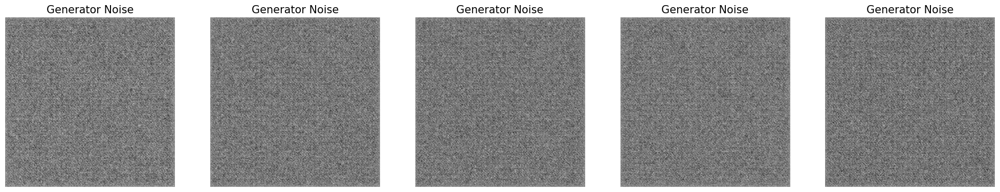

In [ ]:
x_fake = g_model(noise,training=False)
pyplot.figure(figsize=(25,25))
for i in range(n_samples):
    pyplot.subplot(5, 5, 1 + i)
    pyplot.axis('off')
    pyplot.title('Generator Noise',fontsize=15)
    pyplot.imshow(x_fake[i, :, :,0],cmap='gray')
pyplot.show()
pyplot.close()

# **Test Discriminator**

In [ ]:
print (x_fake.shape)

(5, 256, 256, 1)


In [ ]:
d_model.predict(x_fake)

1/1 [==============================] - 0s 118ms/step


array([[-1.3296076e-04],
       [-1.2934487e-04],
       [-9.9958677e-05],
       [-1.9522019e-04],
       [-1.1679360e-04]], dtype=float32)

# **Define loss functions**

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# **Define optimisers**

In [ ]:
generator_optimiser = tf.keras.optimizers.Adam(learning_rate=0.0002)

discriminator_optimiser = tf.keras.optimizers.Adam(learning_rate=0.0001)

# **Training Functions**

In [ ]:
batch_size = 10

def train_step(images):
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = g_model(noise, training=True)

        real_output = d_model(images, training=True)
        fake_output = d_model(generated_images, training=True)

        g_loss = generator_loss(fake_output)
        d_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(g_loss, g_model.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(d_loss, d_model.trainable_variables)

    generator_optimiser.apply_gradients(zip(gradients_of_generator, g_model.trainable_variables))
    discriminator_optimiser.apply_gradients(zip(gradients_of_discriminator, d_model.trainable_variables))
    return g_loss,d_loss 


# **Store generator and discriminator Loss Values**

In [ ]:
d_loss_history = []
g_loss_history = []

# **Training Loop**

Batch and shuffle the data

In [ ]:
total_size=training_images.shape[0]
train_dataset = tf.data.Dataset.from_tensor_slices(training_images).shuffle(total_size).batch(batch_size)

Batch Per Epoch : 0/61
>0, 0/61, g=0.74539411, d=1.68517864


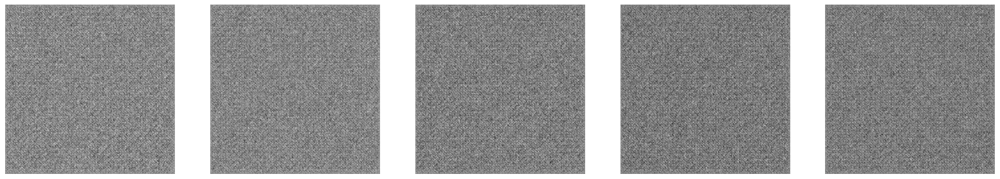

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>1, 0/61, g=5.55752039, d=0.35658699


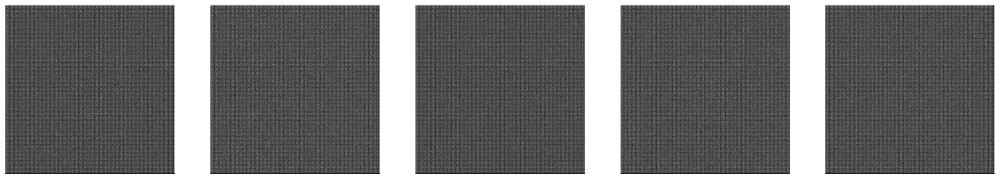

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>2, 0/61, g=1.67526245, d=0.96641666


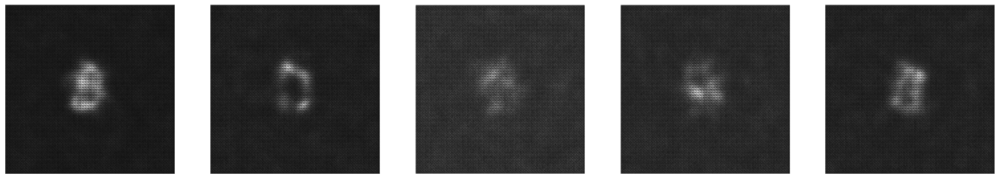

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>3, 0/61, g=1.22808135, d=1.00956059


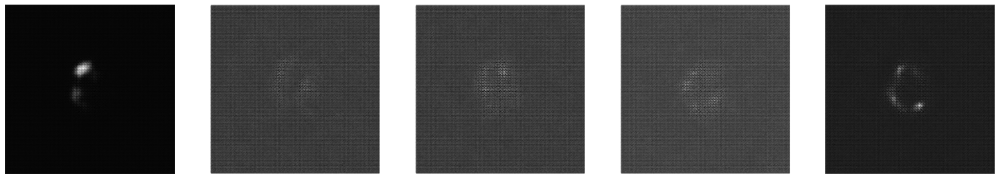

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>4, 0/61, g=0.81011409, d=1.35244656


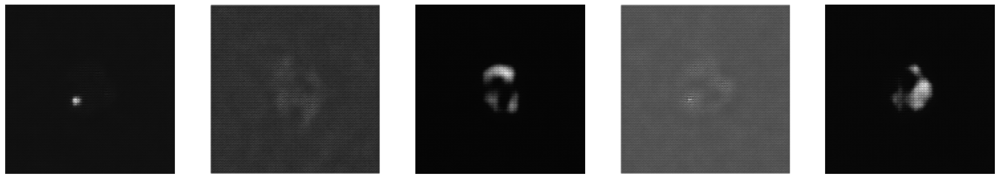

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>5, 0/61, g=2.17821836, d=0.96660984


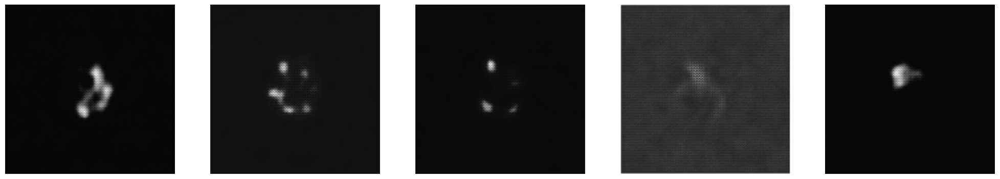

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>6, 0/61, g=1.83037055, d=0.41516191


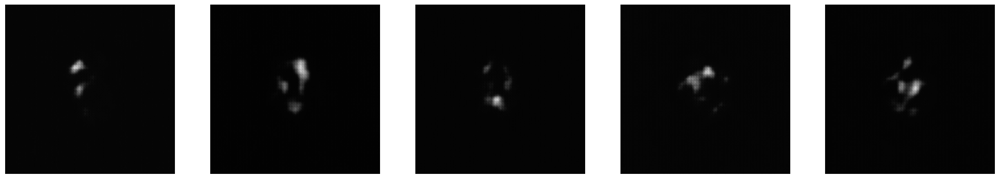

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>7, 0/61, g=1.09233534, d=1.27735734


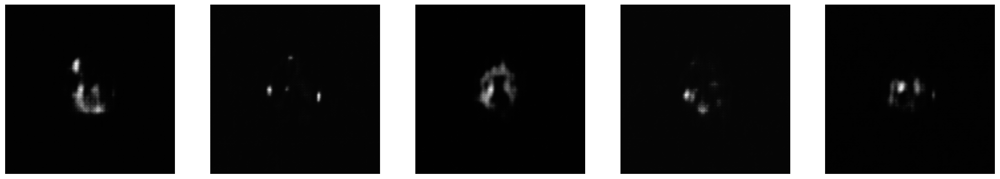

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>8, 0/61, g=2.37822890, d=0.37059873


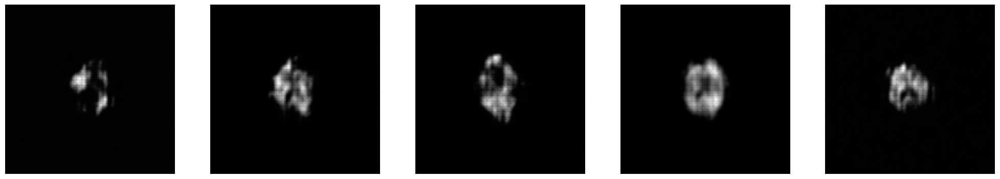

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>9, 0/61, g=2.13843775, d=0.75710309


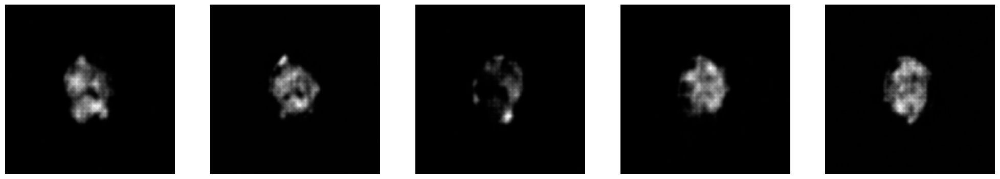

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>10, 0/61, g=3.42617989, d=0.41237187


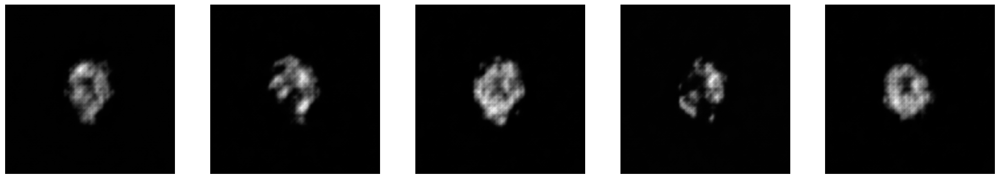

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>11, 0/61, g=1.79109991, d=1.64908433


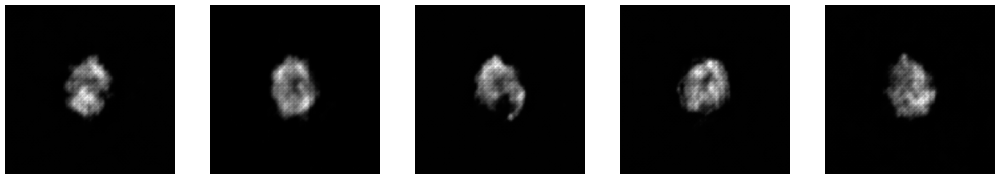

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>12, 0/61, g=1.32879210, d=0.97182292


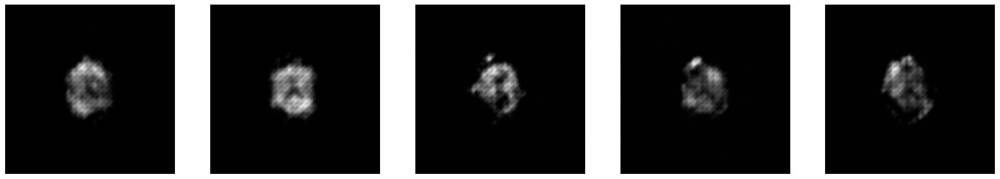

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>13, 0/61, g=0.83195591, d=1.24970746


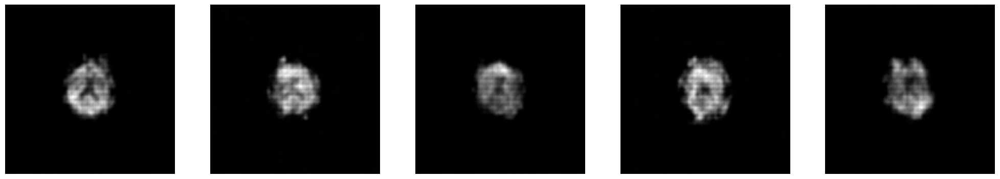

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>14, 0/61, g=1.56466162, d=0.54931194


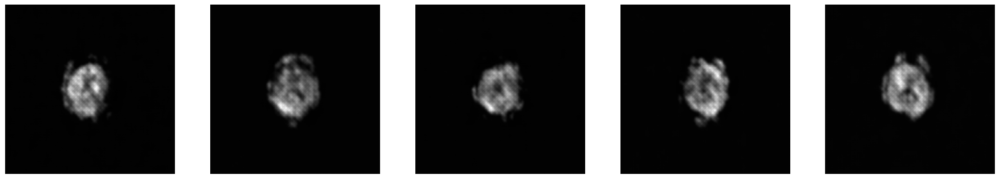

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>15, 0/61, g=1.39620531, d=0.70247269


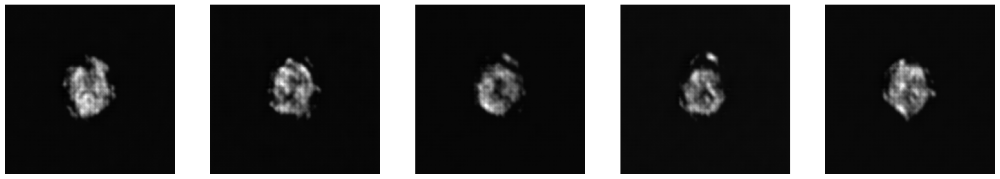

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>16, 0/61, g=0.80057240, d=1.45492339


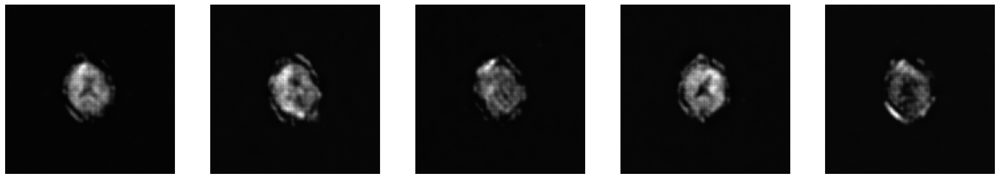

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>17, 0/61, g=1.69974422, d=0.94504595


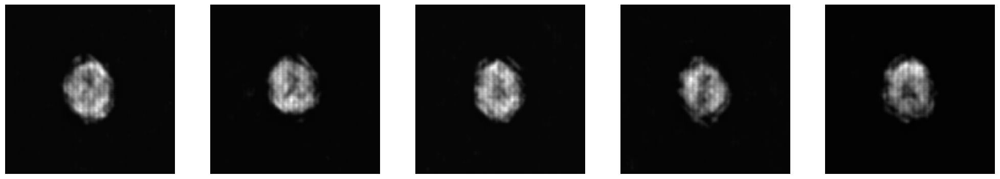

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>18, 0/61, g=0.53306735, d=2.38347363


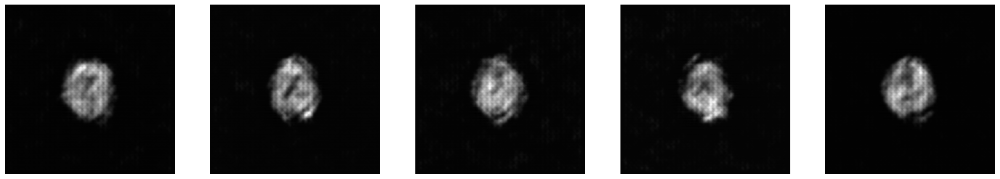

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>19, 0/61, g=1.90053403, d=1.00440288


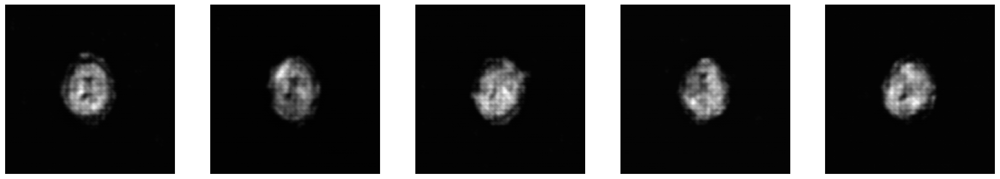

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>20, 0/61, g=0.99286950, d=1.79769075


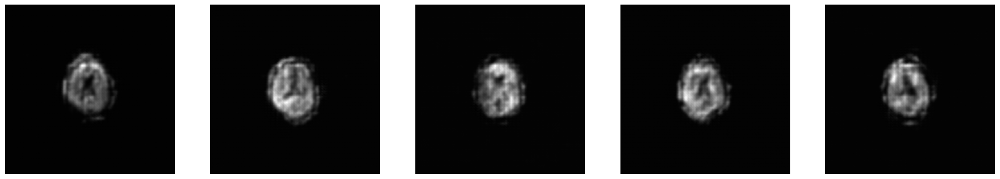

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>21, 0/61, g=0.65808976, d=1.61799026


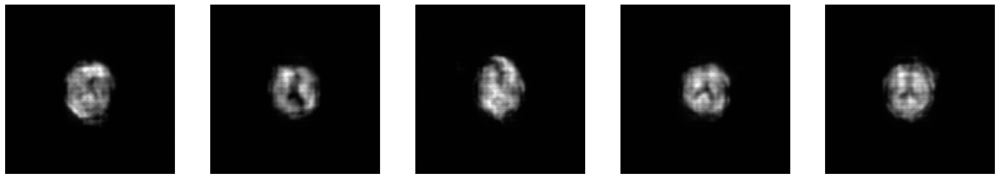

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>22, 0/61, g=0.66299772, d=1.53616798


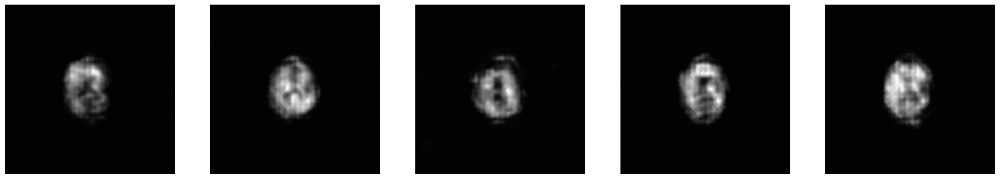

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>23, 0/61, g=0.78627431, d=1.65067160


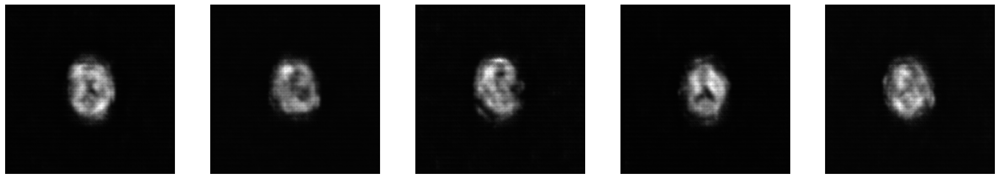

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>24, 0/61, g=0.76782215, d=1.77366924


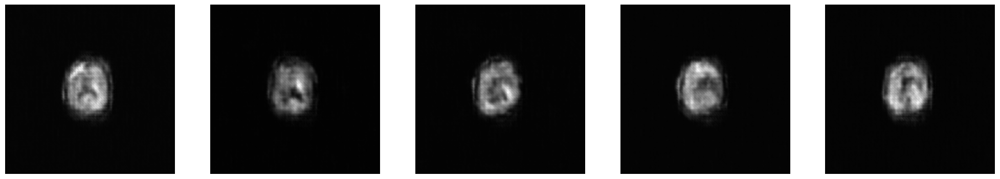

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>25, 0/61, g=0.80695611, d=2.23079443


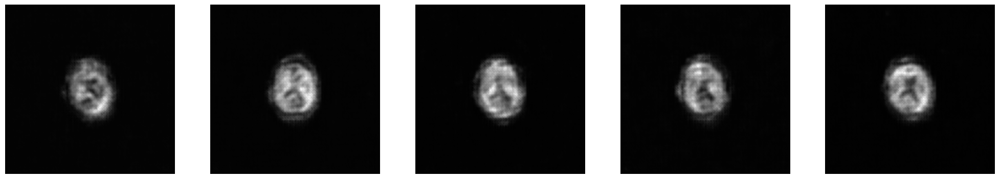

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>26, 0/61, g=1.21595192, d=1.78275561


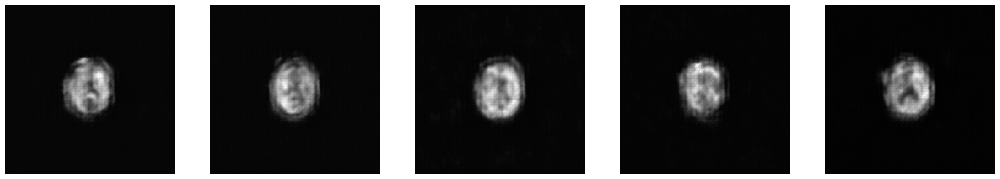

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>27, 0/61, g=1.25726700, d=1.50490093


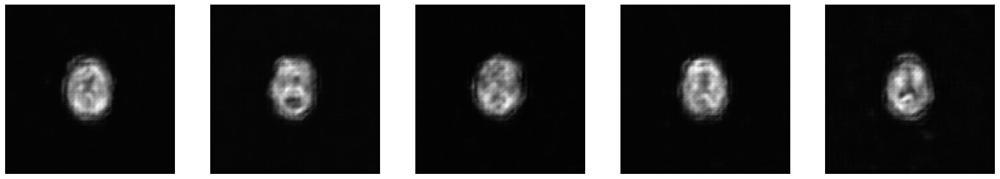

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>28, 0/61, g=0.81888962, d=1.55648732


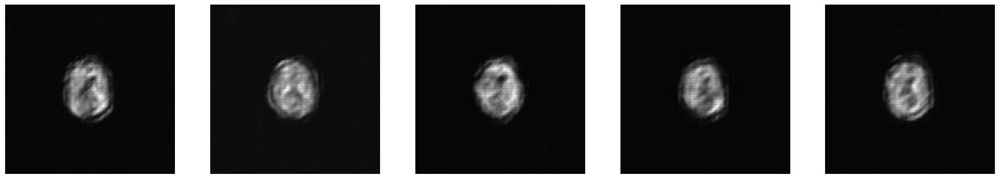

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>29, 0/61, g=0.83760250, d=1.58857751


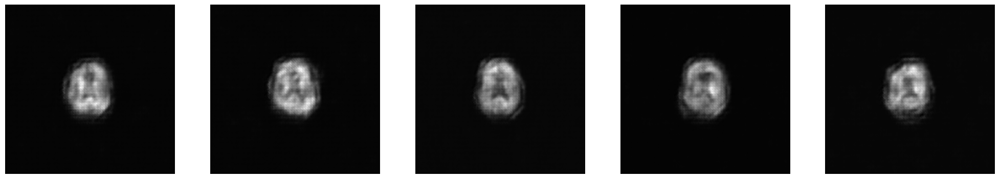

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>30, 0/61, g=0.85883582, d=1.67735577


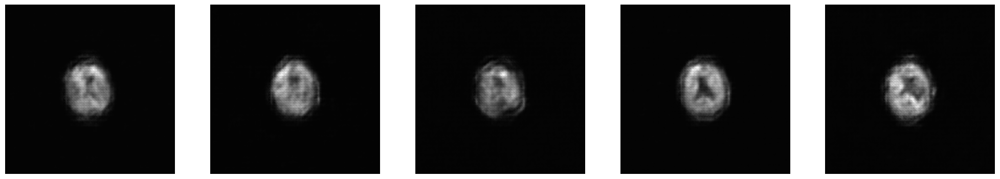

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>31, 0/61, g=0.62598342, d=1.73381400


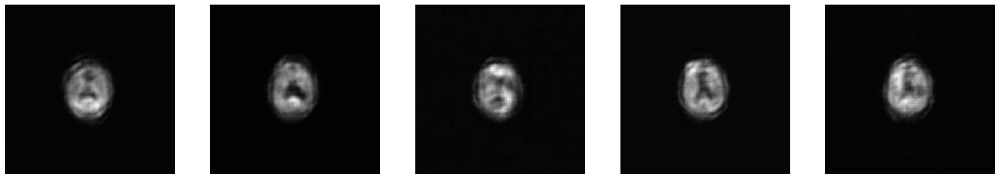

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>32, 0/61, g=0.90844423, d=1.63339984


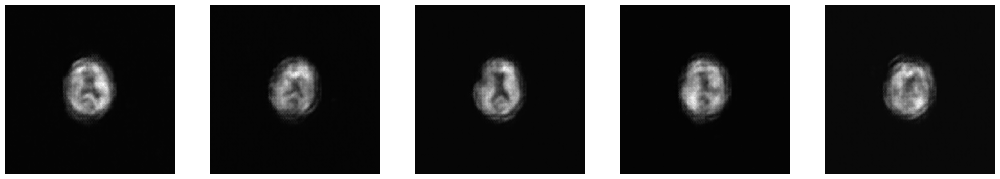

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>33, 0/61, g=0.97411174, d=1.81170952


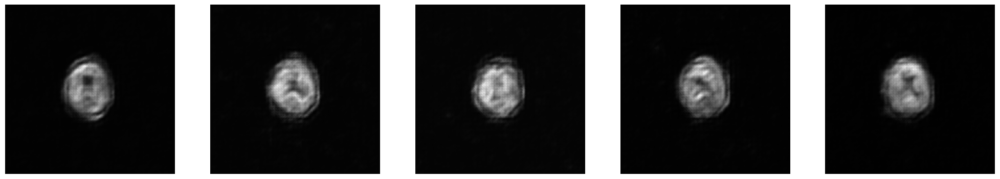

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>34, 0/61, g=0.65175068, d=1.41166925


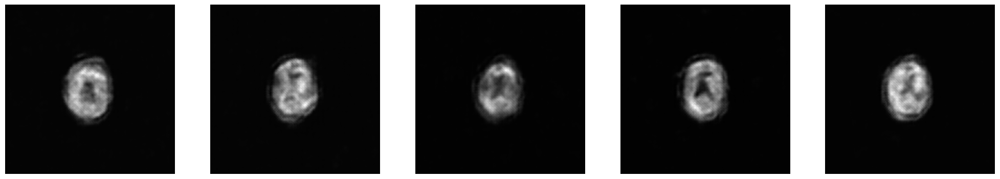

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>35, 0/61, g=0.80417234, d=1.34106648


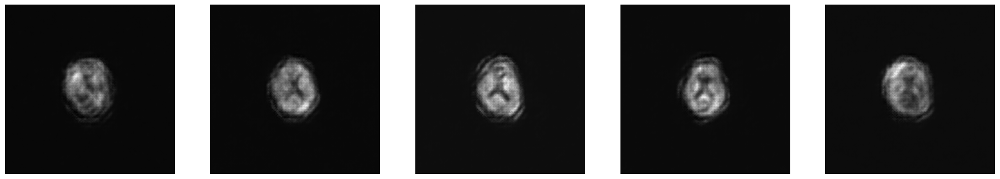

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>36, 0/61, g=0.99095613, d=1.04785085


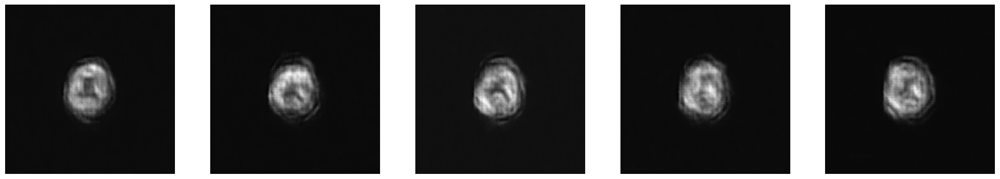

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>37, 0/61, g=0.75805843, d=1.29215384


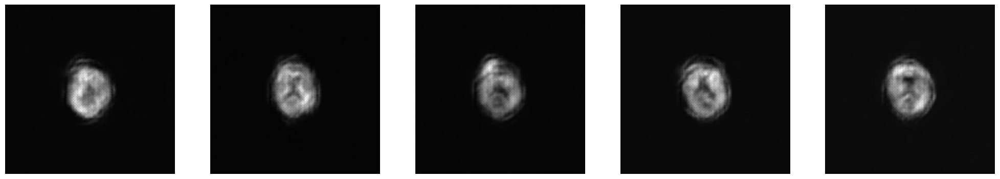

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>38, 0/61, g=0.98332024, d=1.19109941


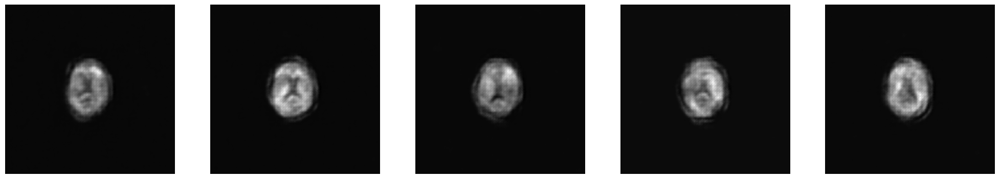

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>39, 0/61, g=1.06411493, d=1.38139319


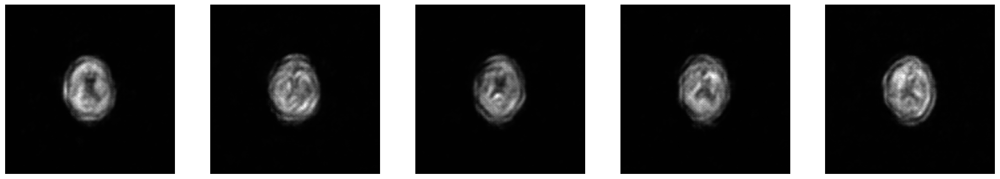

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>40, 0/61, g=0.75540608, d=1.57243586


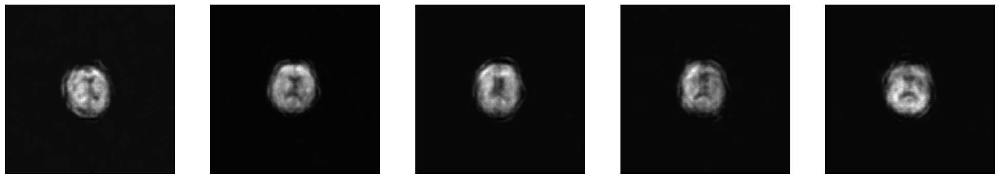

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>41, 0/61, g=0.83640563, d=1.40501142


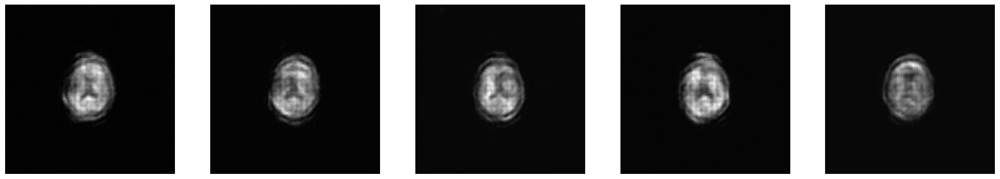

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>42, 0/61, g=1.17478526, d=1.24622333


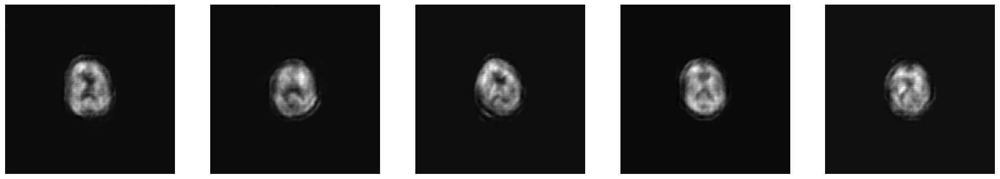

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>43, 0/61, g=0.91779470, d=1.62010288


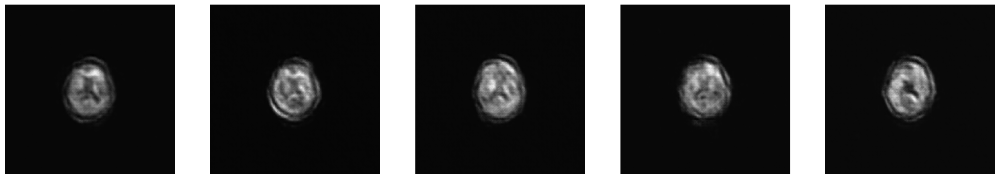

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>44, 0/61, g=0.71167213, d=1.80918837


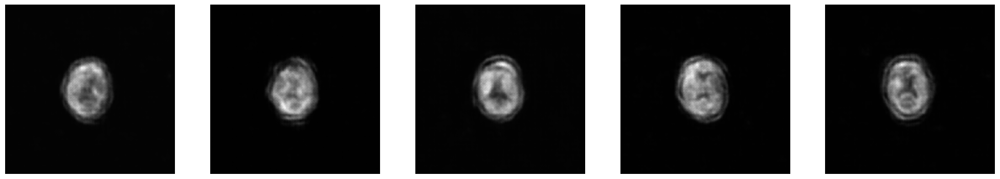

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>45, 0/61, g=1.29544806, d=1.32337594


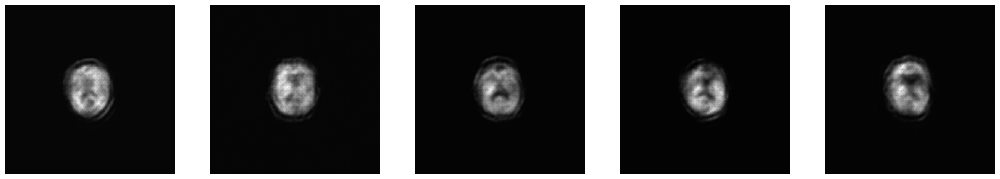

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>46, 0/61, g=1.03180397, d=1.28011155


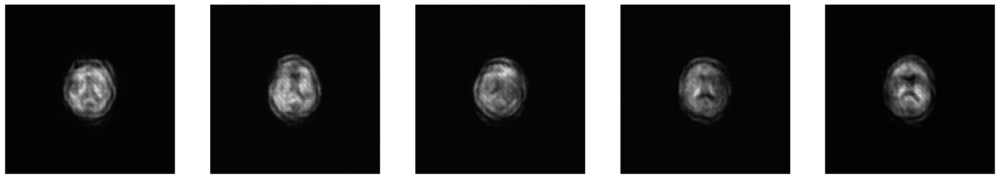

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>47, 0/61, g=1.03886437, d=1.56444836


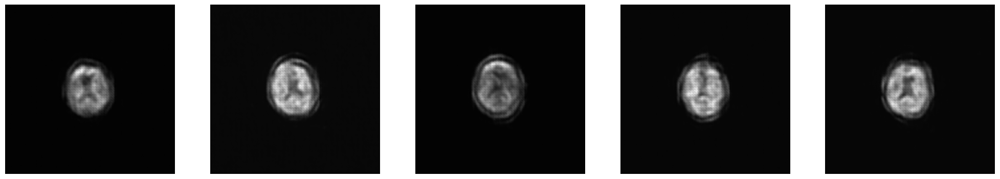

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>48, 0/61, g=0.85238266, d=1.30975366


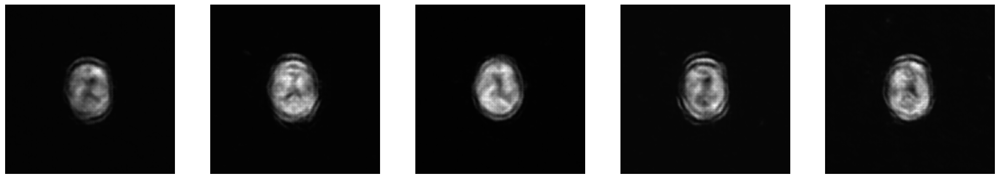

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>49, 0/61, g=0.93655097, d=1.12067342


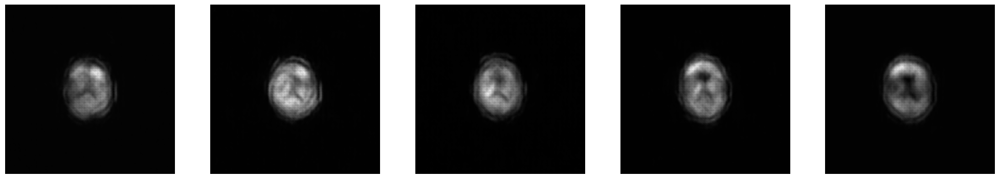

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>50, 0/61, g=1.02566278, d=1.13207912


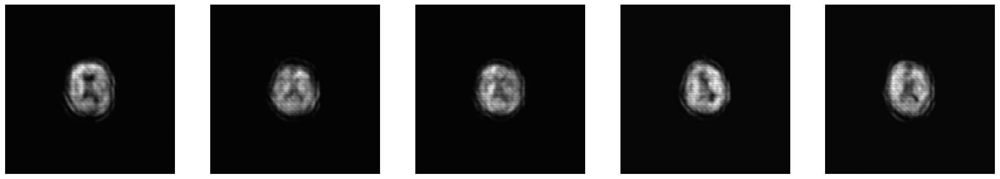

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>51, 0/61, g=0.90941793, d=1.26365781


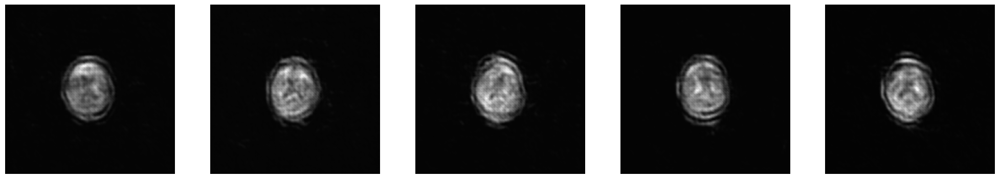

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>52, 0/61, g=1.57404530, d=0.73025334


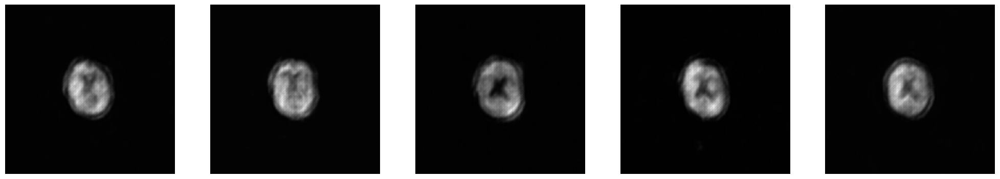

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>53, 0/61, g=1.14777815, d=1.45122433


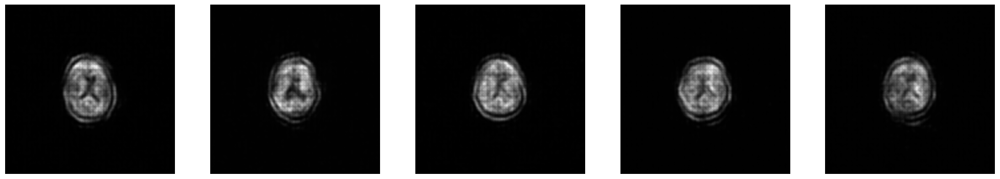

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>54, 0/61, g=1.71034980, d=0.84452629


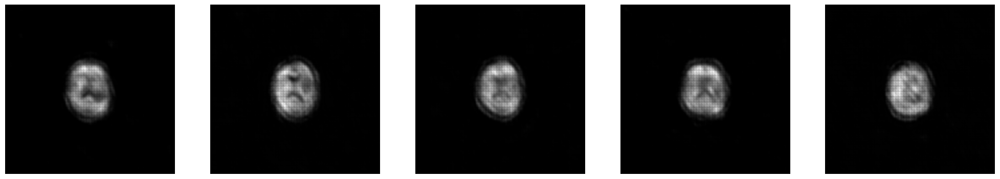

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>55, 0/61, g=1.14237857, d=1.14804006


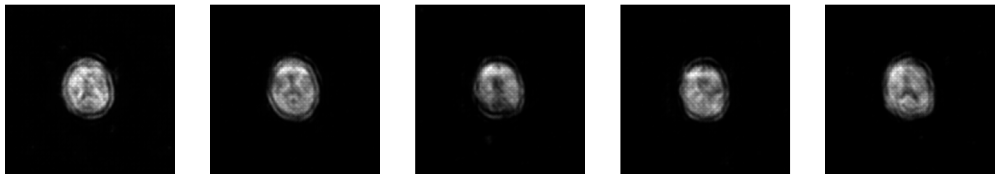

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>56, 0/61, g=0.85615671, d=1.69361198


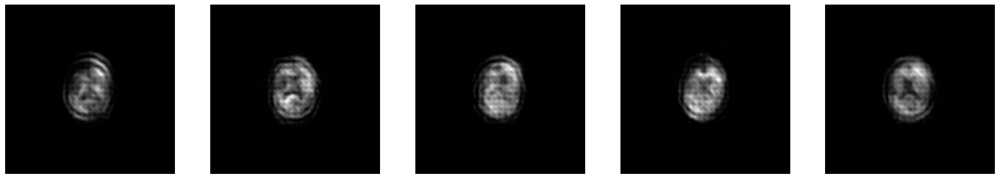

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>57, 0/61, g=1.09730506, d=1.34242892


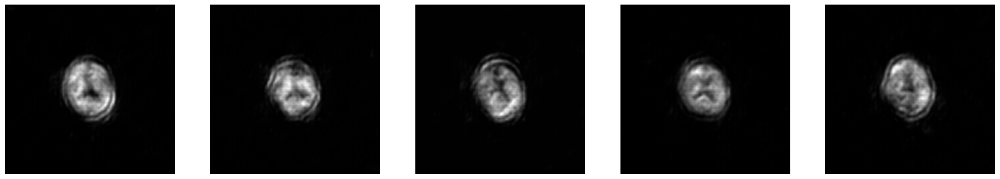

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>58, 0/61, g=1.44972348, d=0.99755812


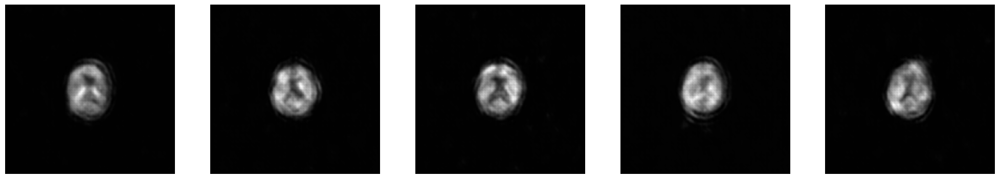

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>59, 0/61, g=1.48495197, d=0.92184007


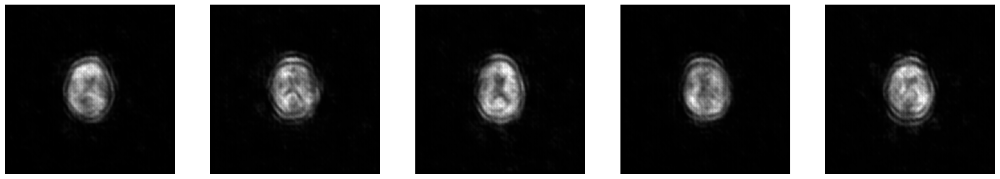

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>60, 0/61, g=1.28730488, d=1.04363310


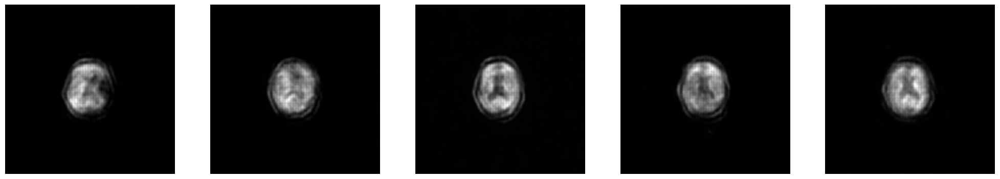

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>61, 0/61, g=0.81448019, d=1.40547550


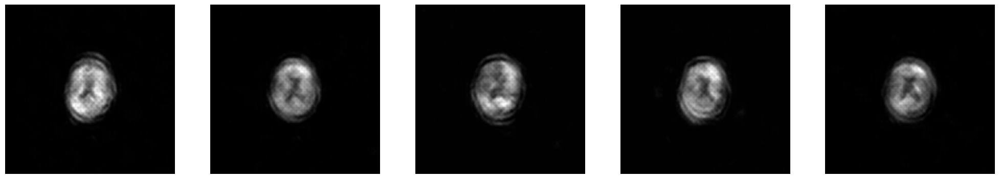

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>62, 0/61, g=0.63964194, d=1.12872875


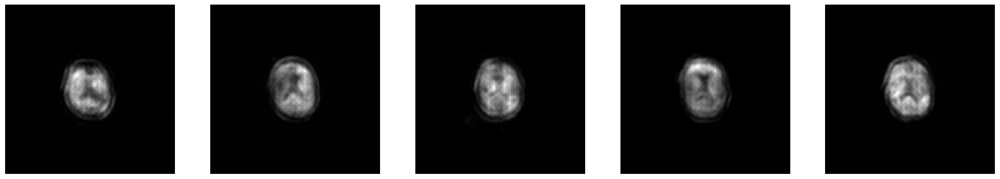

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>63, 0/61, g=1.19611156, d=1.01563001


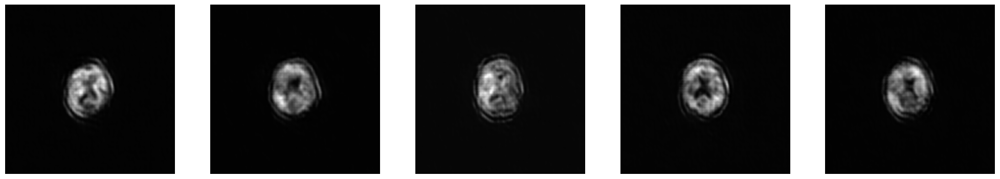

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>64, 0/61, g=0.98474872, d=1.38804328


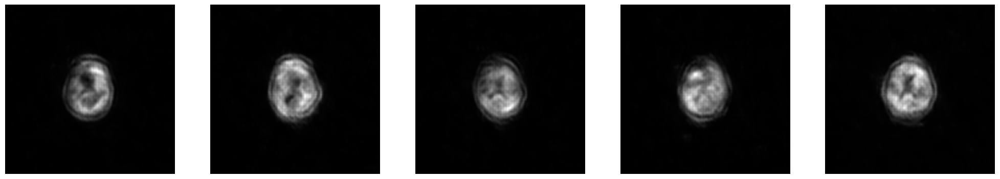

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>65, 0/61, g=1.24791956, d=0.95595598


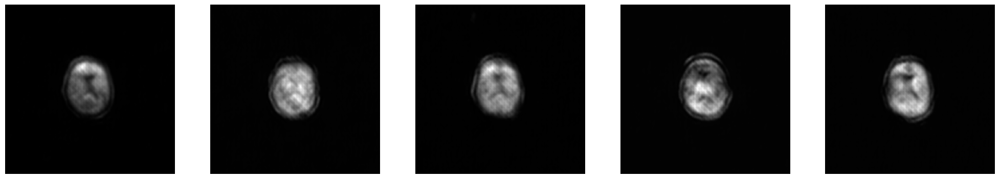

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>66, 0/61, g=1.71526527, d=1.14508152


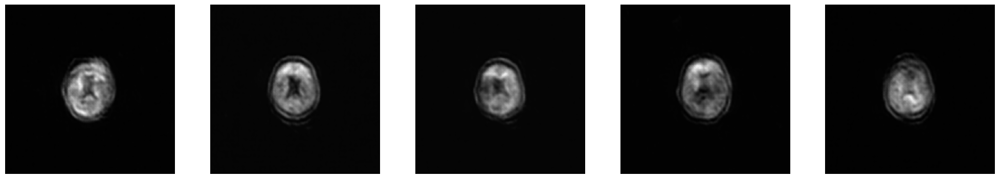

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>67, 0/61, g=0.71694738, d=1.66708636


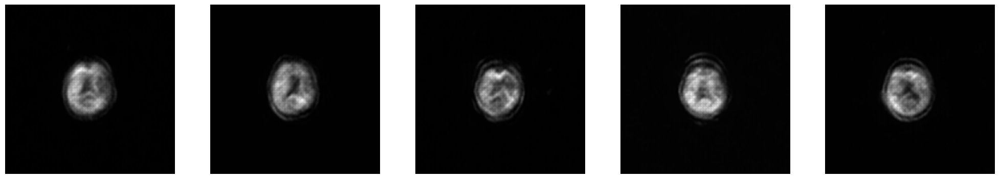

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>68, 0/61, g=0.60603327, d=1.66574073


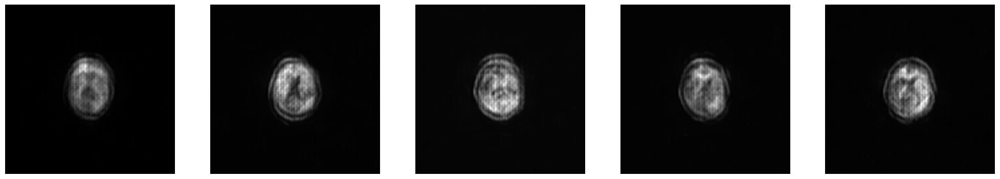

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>69, 0/61, g=0.39383551, d=2.06687689


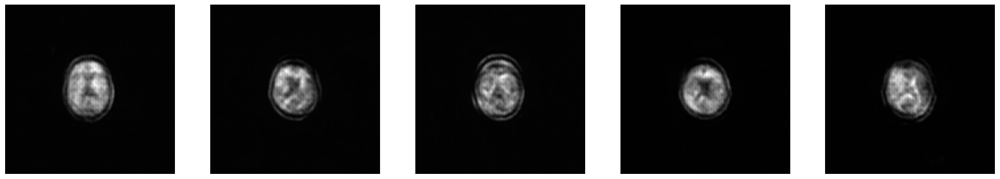

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>70, 0/61, g=1.66243458, d=0.79169697


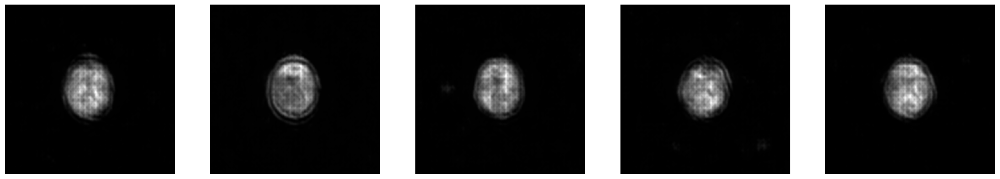

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>71, 0/61, g=1.30009472, d=1.08543003


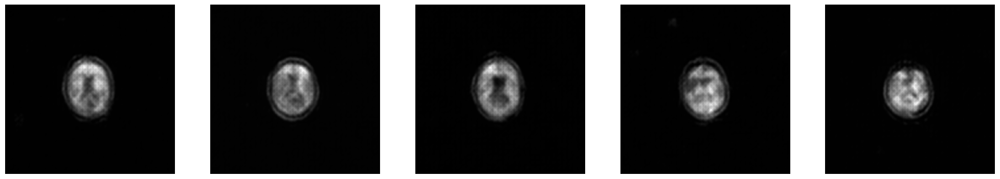

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>72, 0/61, g=0.83569974, d=1.45886421


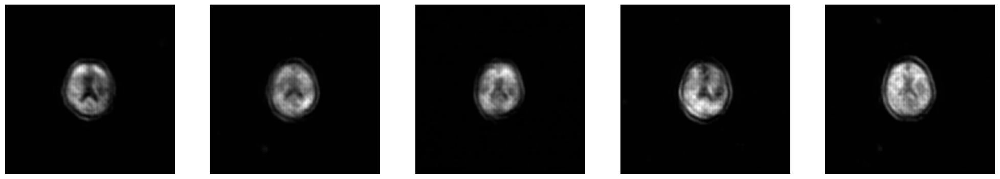

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>73, 0/61, g=0.93128026, d=1.55067515


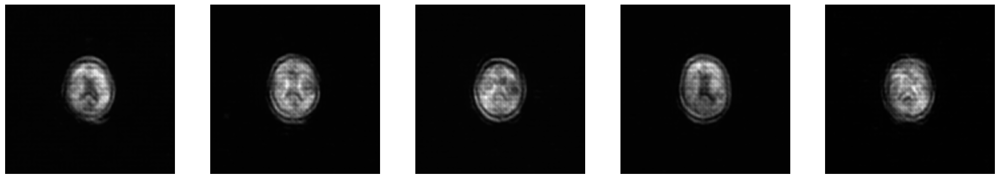

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>74, 0/61, g=0.72227228, d=1.61265624


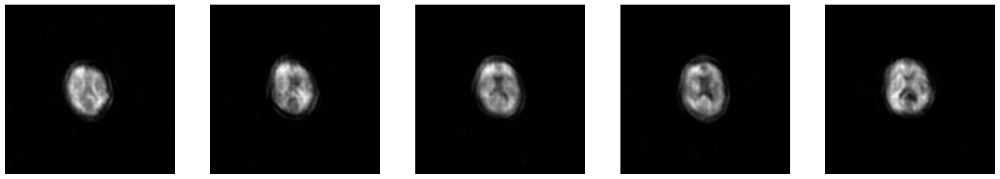

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>75, 0/61, g=0.84143370, d=1.39669466


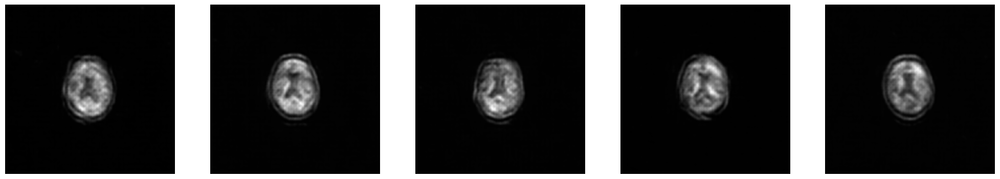

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>76, 0/61, g=0.88105220, d=1.42975295


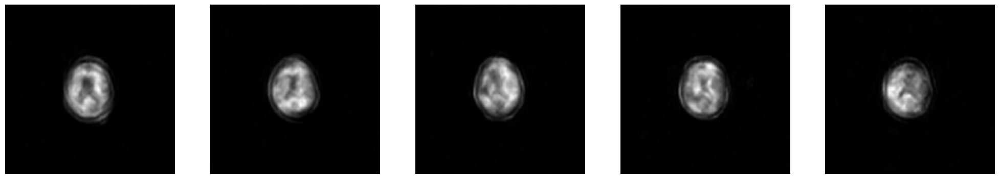

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>77, 0/61, g=0.67307293, d=1.79291749


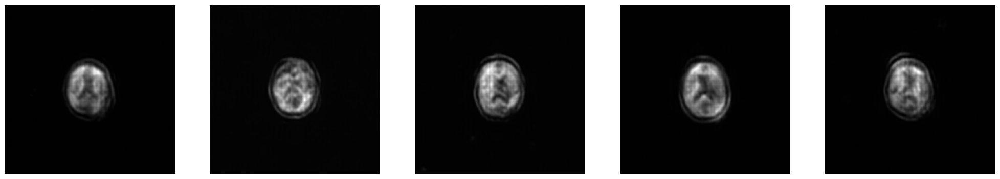

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>78, 0/61, g=0.62304533, d=1.51862037


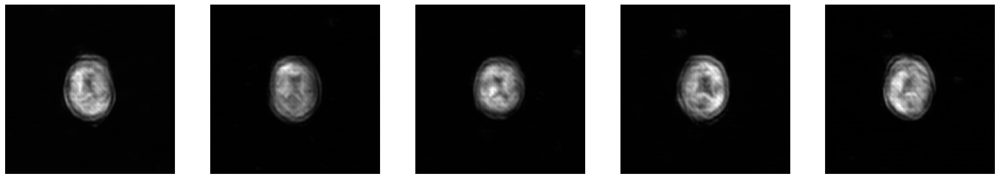

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>79, 0/61, g=0.74681771, d=1.36504388


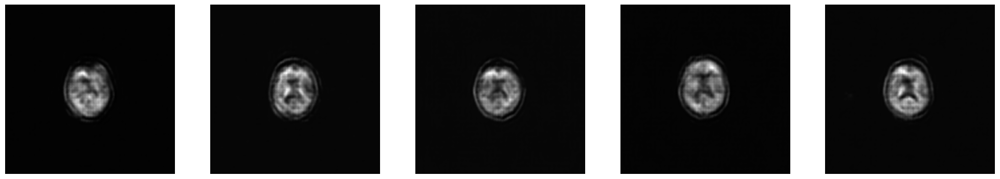

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>80, 0/61, g=0.70450181, d=1.55365264


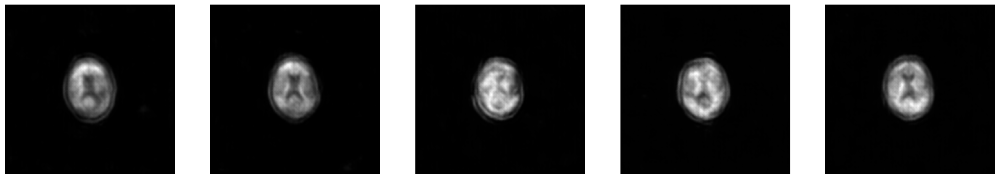

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>81, 0/61, g=0.55286568, d=1.42712247


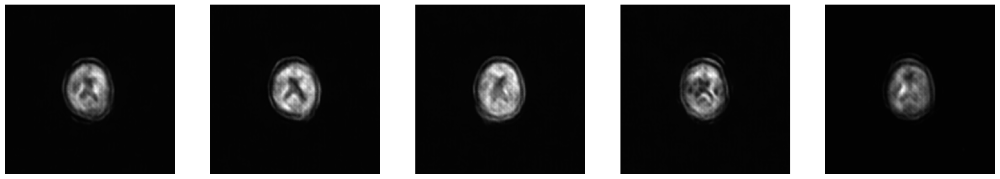

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>82, 0/61, g=1.05727255, d=1.27059138


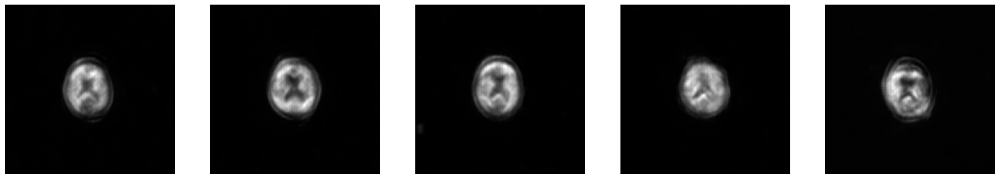

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>83, 0/61, g=1.16298544, d=1.11664331


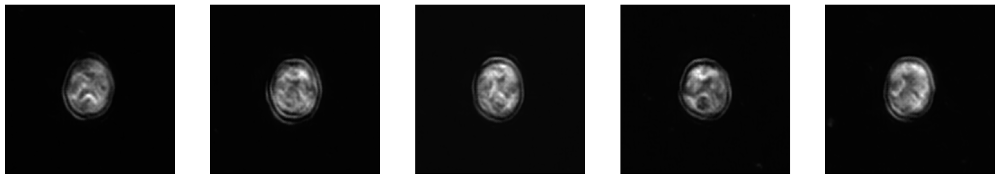

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>84, 0/61, g=0.67177331, d=1.58400249


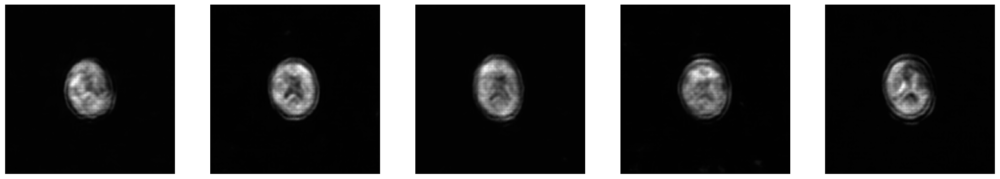

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>85, 0/61, g=0.89890510, d=0.99153495


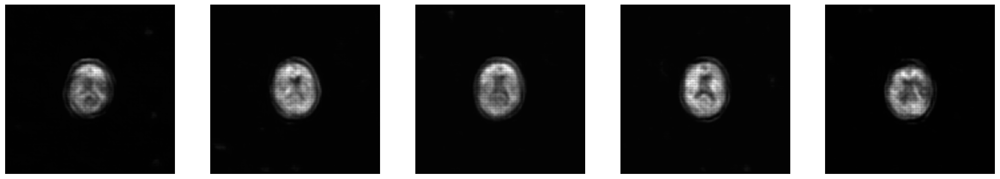

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>86, 0/61, g=1.04961288, d=1.04589033


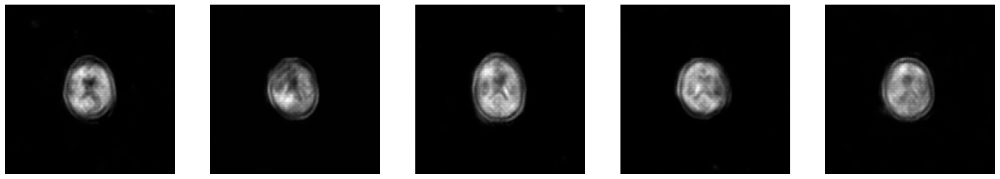

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>87, 0/61, g=1.50849915, d=0.66873282


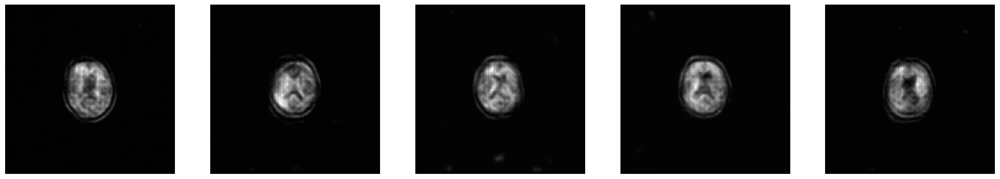

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>88, 0/61, g=1.30106235, d=1.09616899


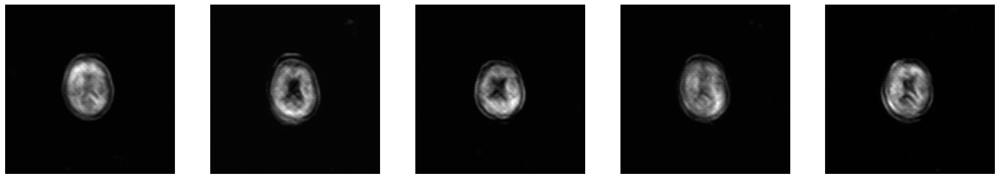

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>89, 0/61, g=1.34684074, d=1.04249144


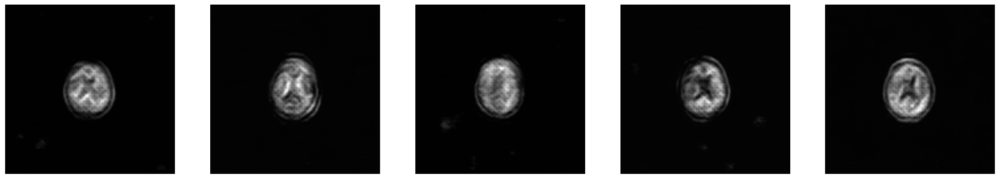

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>90, 0/61, g=2.13490033, d=1.15891957


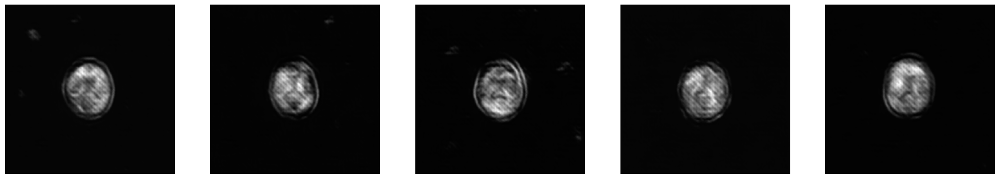

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>91, 0/61, g=0.84820777, d=0.98658347


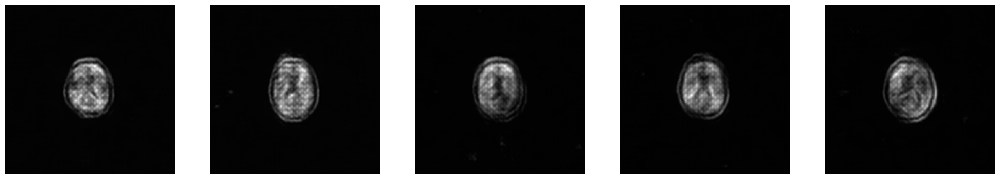

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>92, 0/61, g=1.02605677, d=1.13498974


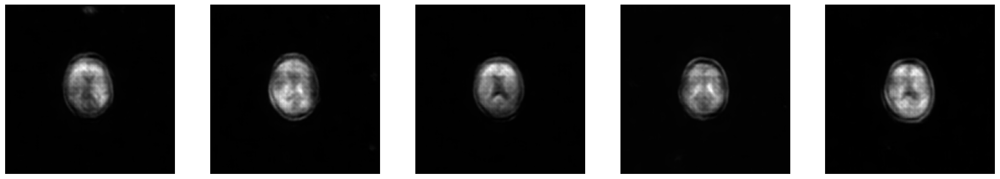

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>93, 0/61, g=0.91590500, d=1.17533374


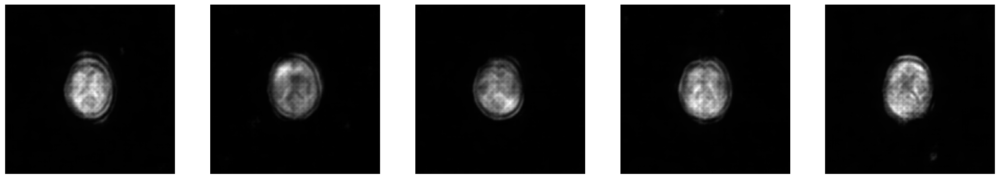

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>94, 0/61, g=0.99980128, d=1.24199748


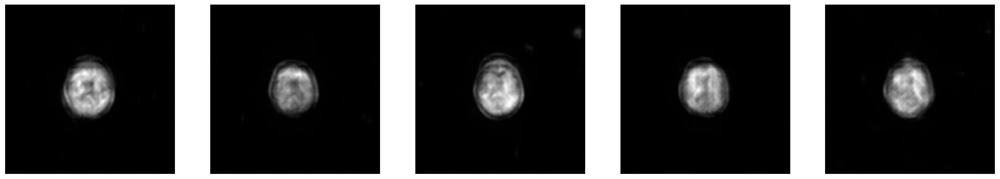

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>95, 0/61, g=0.66012156, d=1.29959202


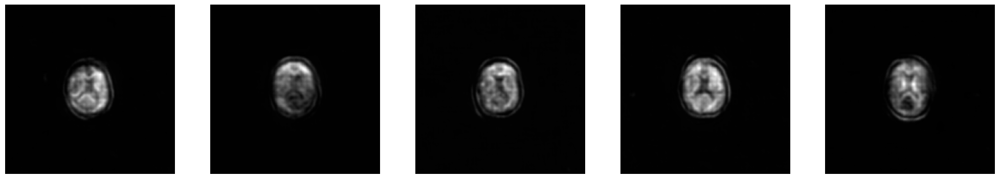

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>96, 0/61, g=1.48699689, d=1.47111678


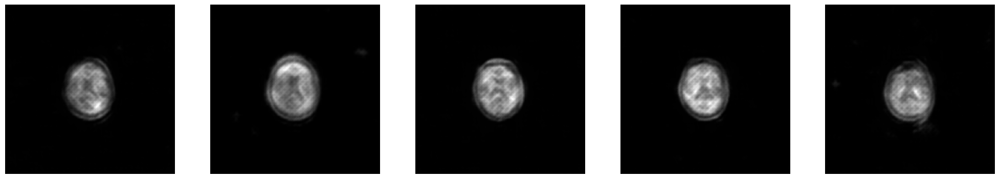

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>97, 0/61, g=1.73901820, d=1.03888321


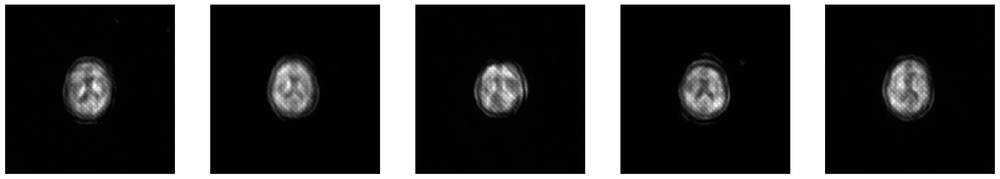

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>98, 0/61, g=1.01466453, d=1.38630104


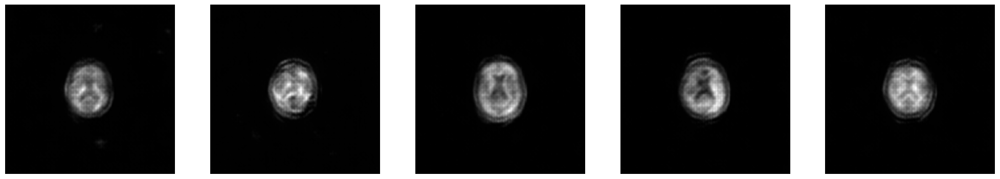

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>99, 0/61, g=1.00735068, d=1.05684376


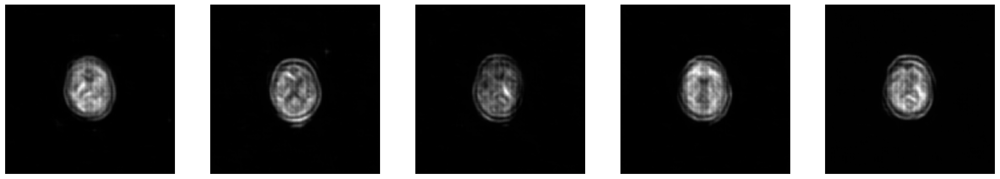

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>100, 0/61, g=1.28585958, d=0.77821612


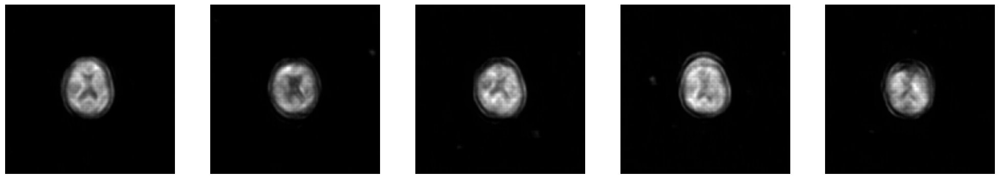

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>101, 0/61, g=0.85261691, d=1.23273492


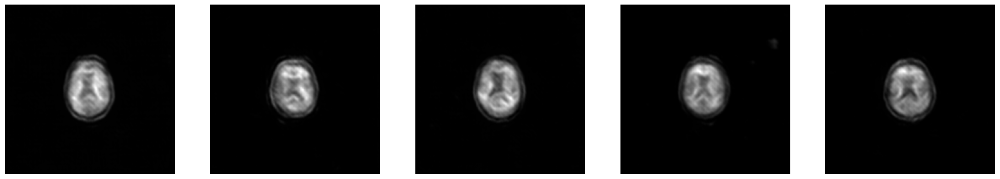

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>102, 0/61, g=0.62841219, d=1.50724232


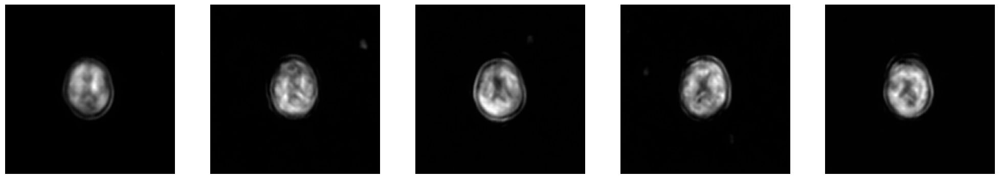

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>103, 0/61, g=1.13476562, d=1.05267358


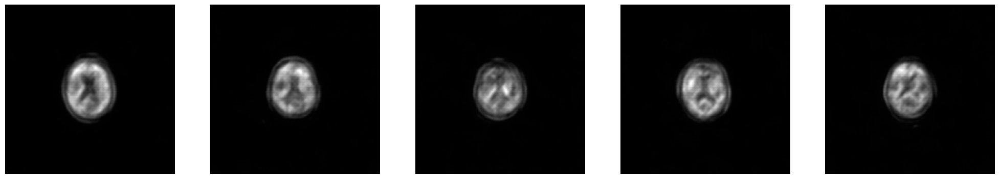

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>104, 0/61, g=1.79018247, d=1.34665108


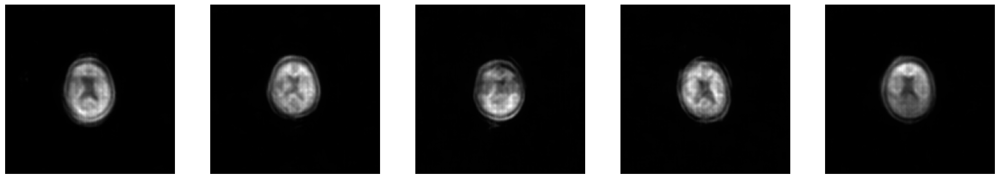

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>105, 0/61, g=1.29540122, d=0.85940188


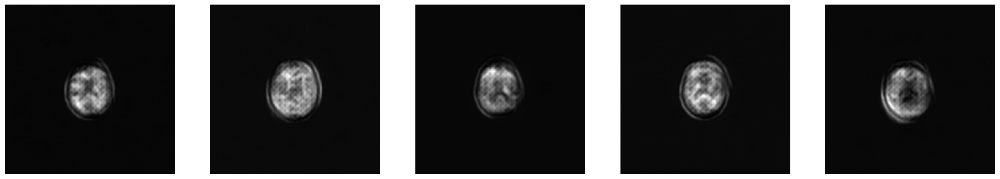

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>106, 0/61, g=0.86519682, d=1.17699575


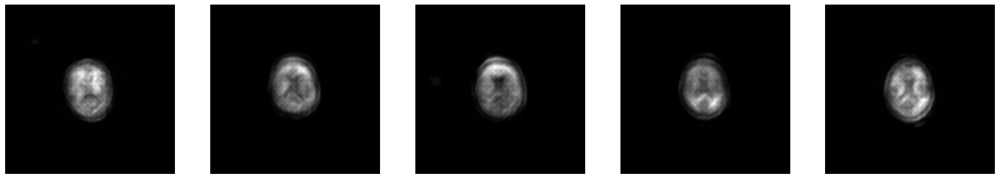

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>107, 0/61, g=0.81924564, d=1.81325722


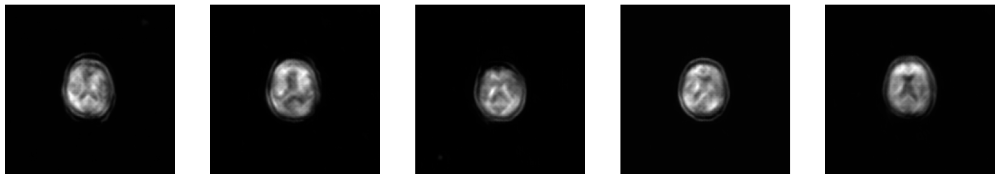

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>108, 0/61, g=0.73937607, d=1.52986884


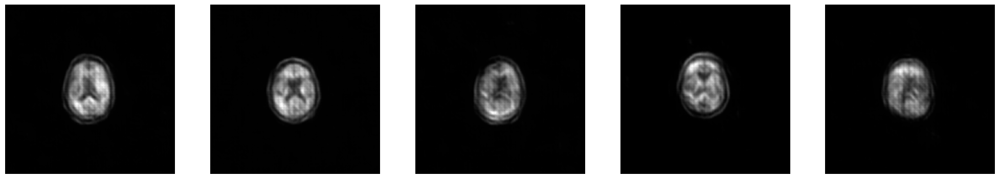

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>109, 0/61, g=1.96780849, d=0.69388294


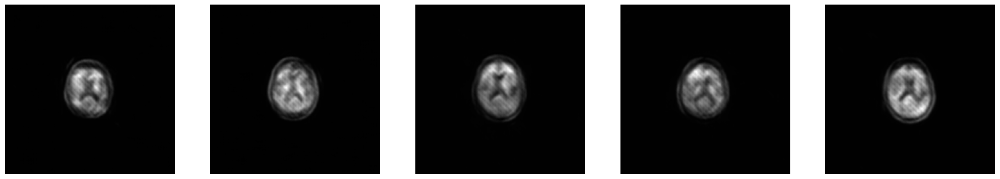

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>110, 0/61, g=1.72814691, d=0.98324728


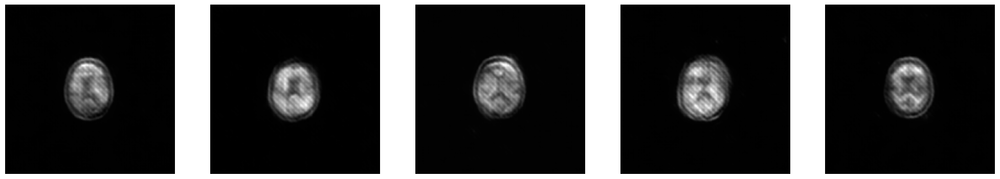

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>111, 0/61, g=0.94531888, d=1.31936657


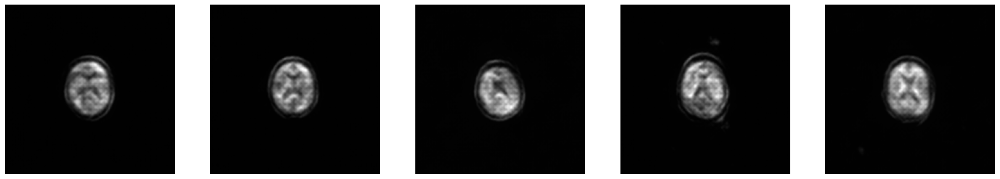

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>112, 0/61, g=0.78737926, d=1.61505640


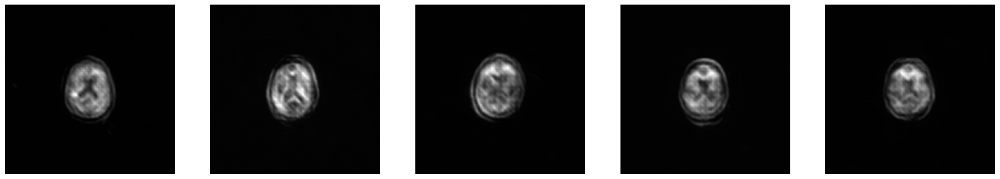

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>113, 0/61, g=0.81849611, d=1.31029582


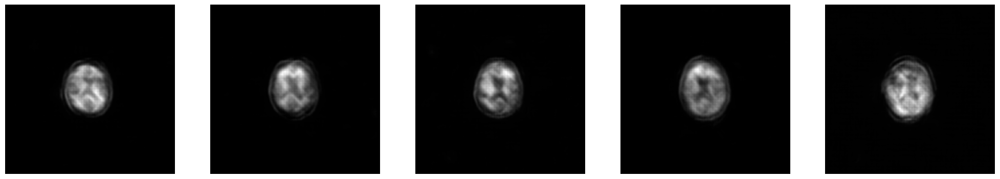

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>114, 0/61, g=1.73922884, d=1.25840735


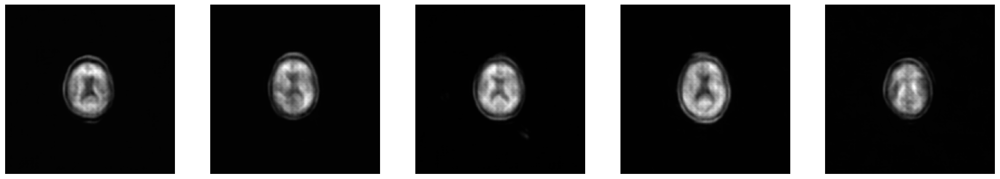

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>115, 0/61, g=1.04026651, d=0.92397469


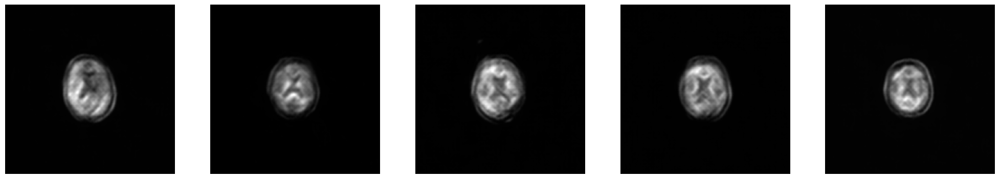

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>116, 0/61, g=1.06537509, d=0.85613084


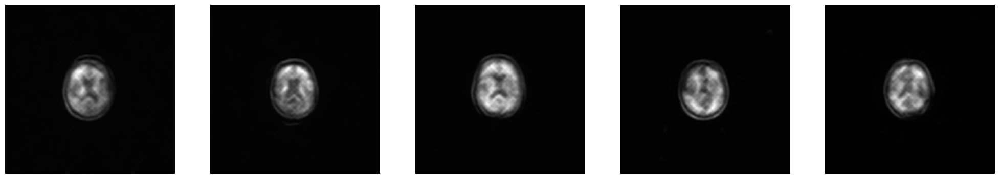

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>117, 0/61, g=1.21453989, d=1.38132858


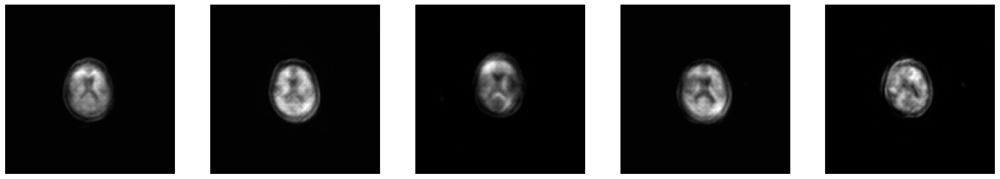

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>118, 0/61, g=0.83991927, d=1.43989921


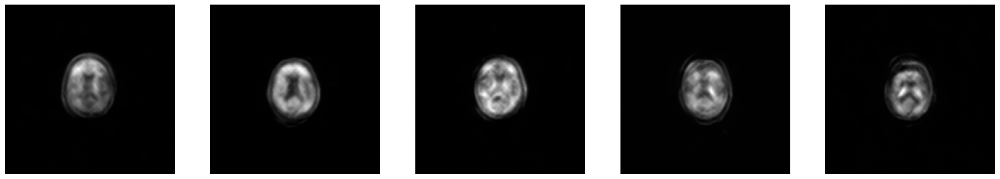

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>119, 0/61, g=1.29840171, d=0.98608679


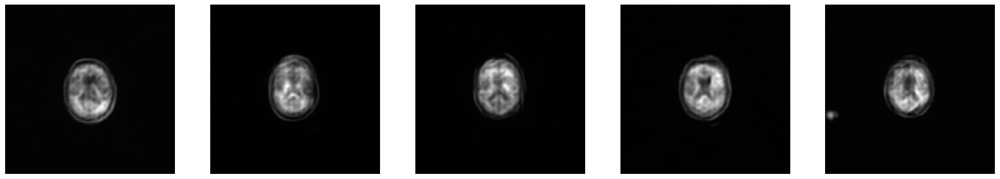

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>120, 0/61, g=0.74720329, d=1.45383239


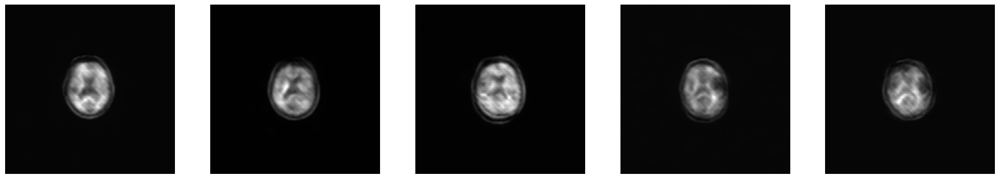

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>121, 0/61, g=0.95721865, d=1.43180823


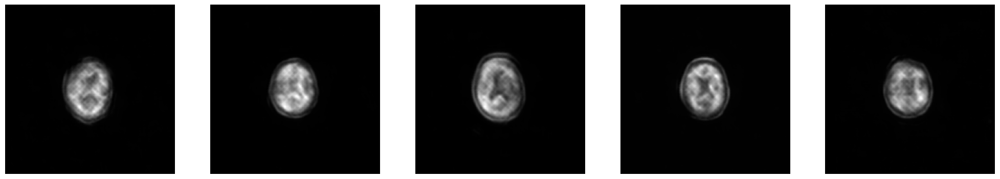

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>122, 0/61, g=0.86300200, d=1.27109909


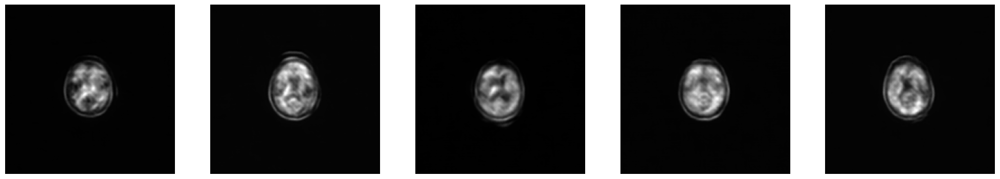

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>123, 0/61, g=0.99004519, d=1.55631876


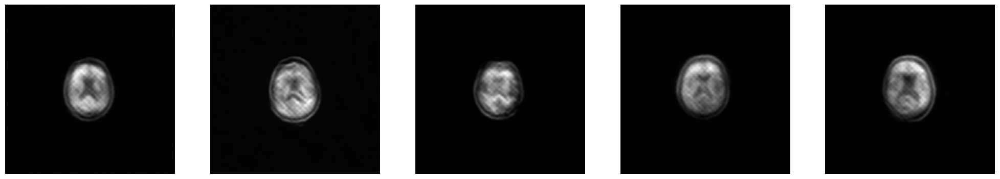

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>124, 0/61, g=0.52019817, d=1.48296916


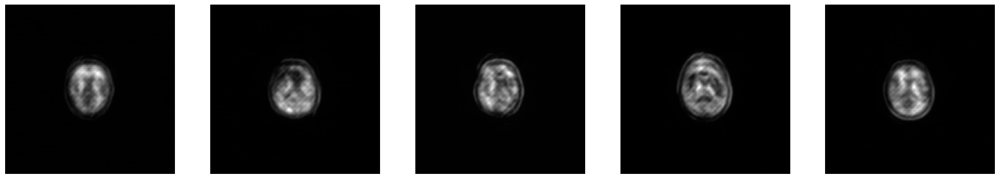

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>125, 0/61, g=1.17758858, d=0.96955580


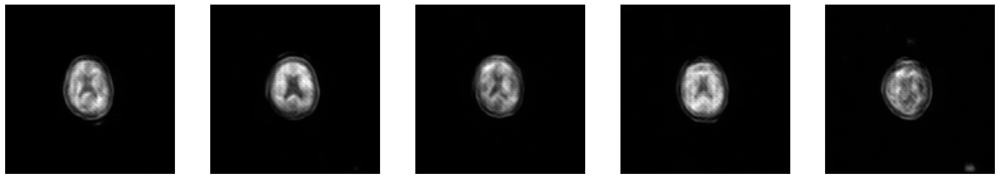

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>126, 0/61, g=0.69085681, d=1.23066282


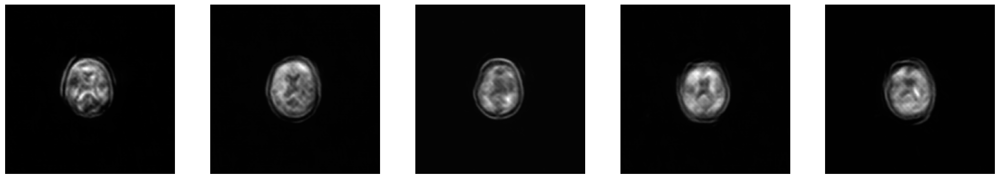

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>127, 0/61, g=1.73631251, d=0.99112731


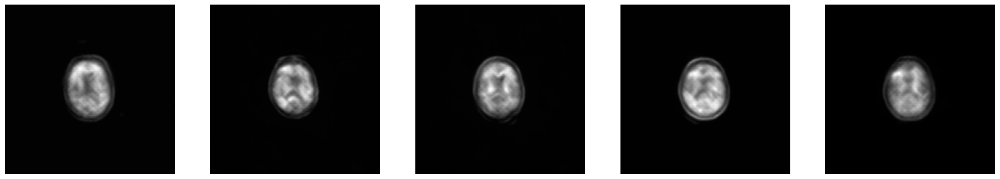

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>128, 0/61, g=0.74094629, d=0.95728153


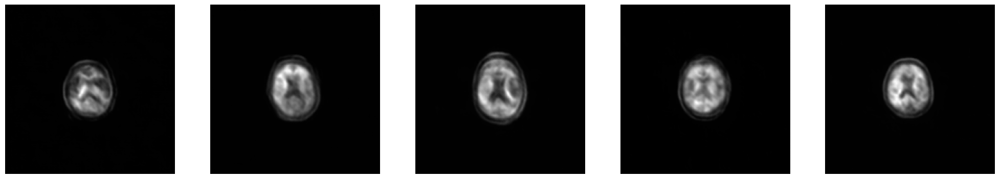

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>129, 0/61, g=1.08512616, d=1.36161399


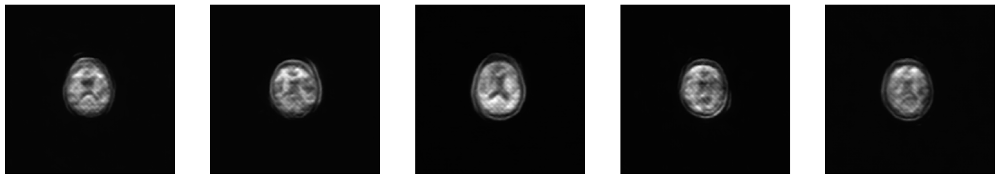

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>130, 0/61, g=1.03908312, d=1.99182296


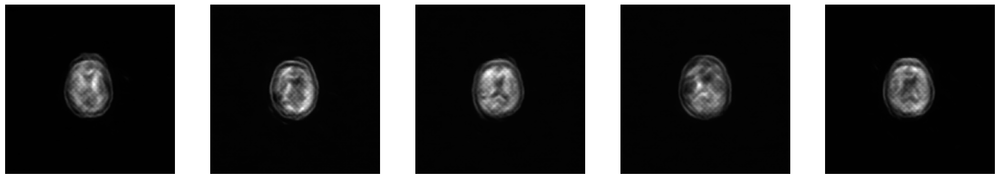

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>131, 0/61, g=0.50853670, d=1.81871510


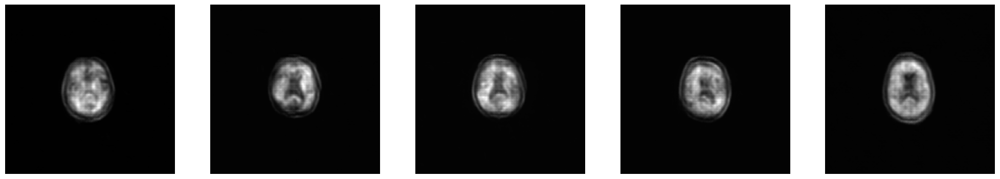

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>132, 0/61, g=0.59155226, d=1.65935159


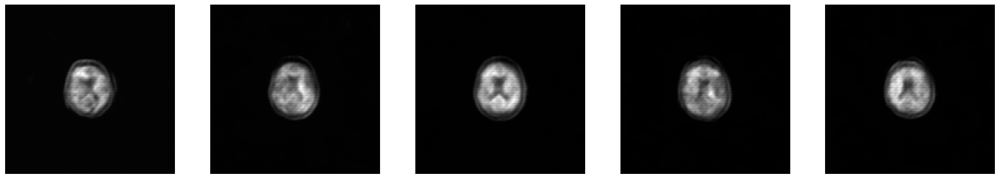

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>133, 0/61, g=1.43604290, d=1.49374557


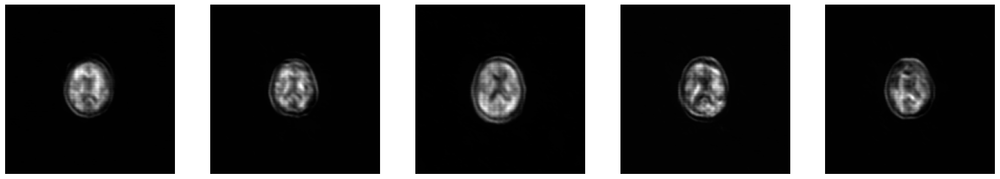

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>134, 0/61, g=0.66516477, d=1.80770350


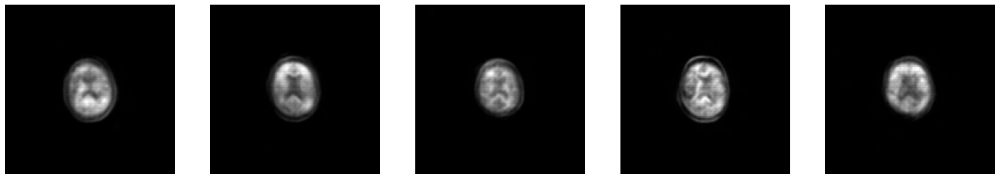

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>135, 0/61, g=0.68580979, d=1.53277326


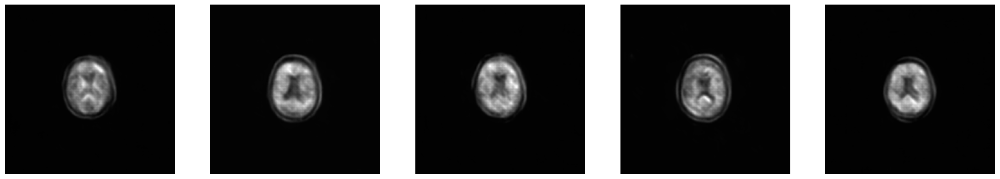

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>136, 0/61, g=1.13187921, d=1.00379407


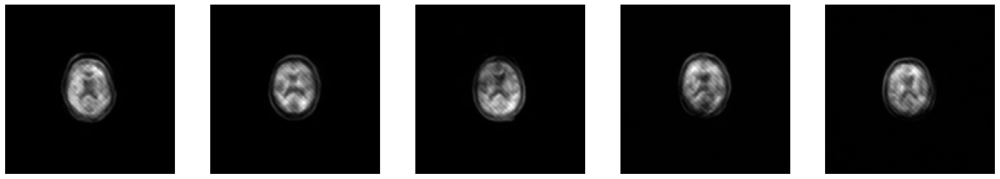

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>137, 0/61, g=0.87281531, d=1.71164775


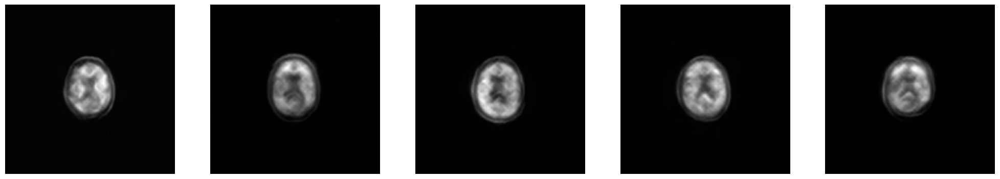

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>138, 0/61, g=1.45870554, d=0.94543517


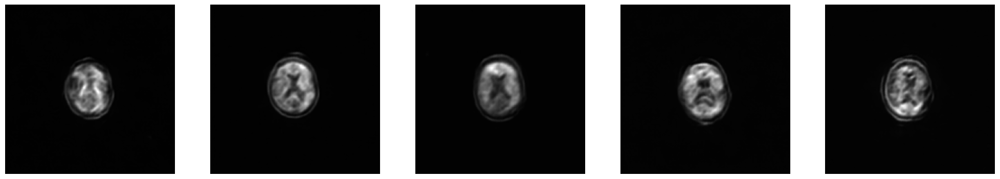

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>139, 0/61, g=0.78913295, d=1.49404430


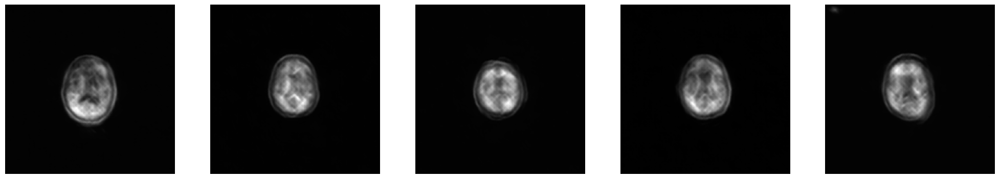

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>140, 0/61, g=1.24628770, d=1.14122355


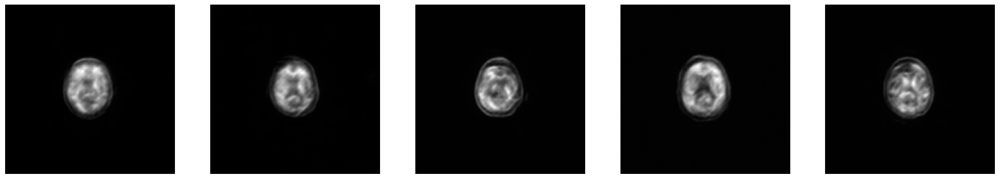

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>141, 0/61, g=1.03551972, d=1.30132985


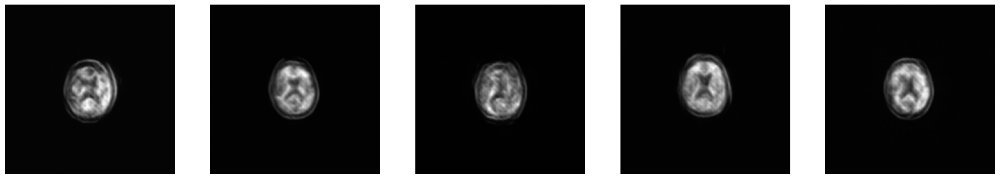

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>142, 0/61, g=0.77309060, d=1.58720767


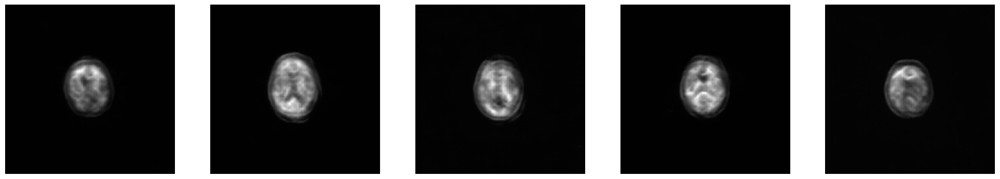

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>143, 0/61, g=0.85207427, d=0.98795748


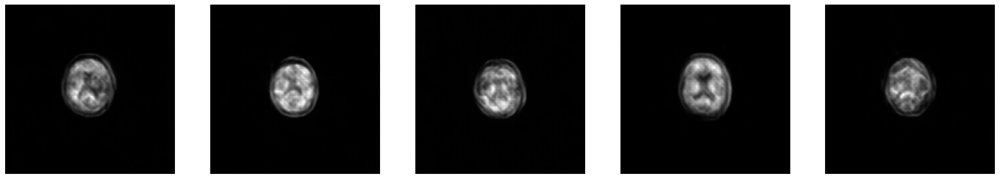

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>144, 0/61, g=0.97718096, d=1.10652161


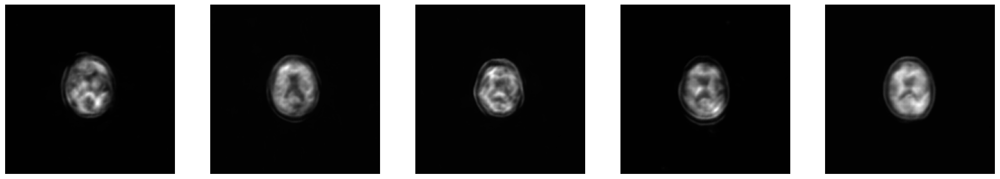

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>145, 0/61, g=0.71271563, d=1.25100935


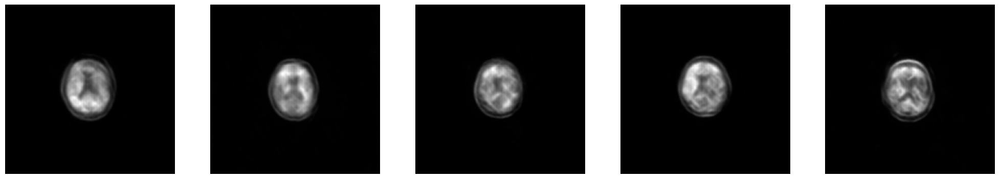

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>146, 0/61, g=1.49352288, d=0.93177772


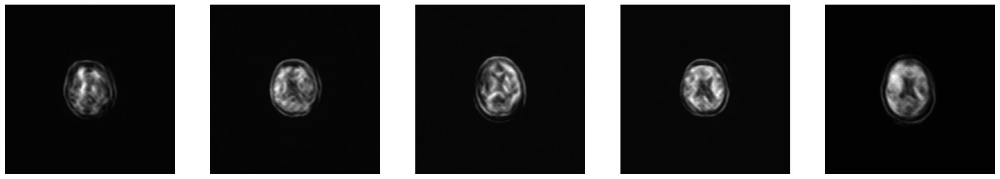

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>147, 0/61, g=1.37751830, d=1.10127473


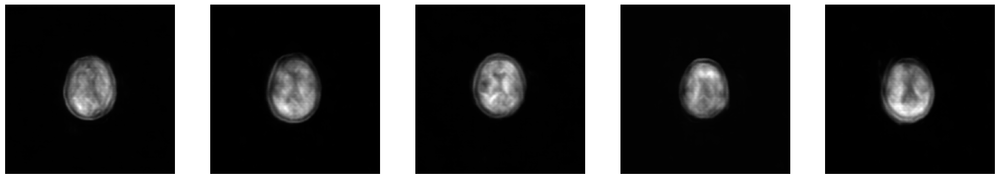

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>148, 0/61, g=0.87814093, d=1.26414466


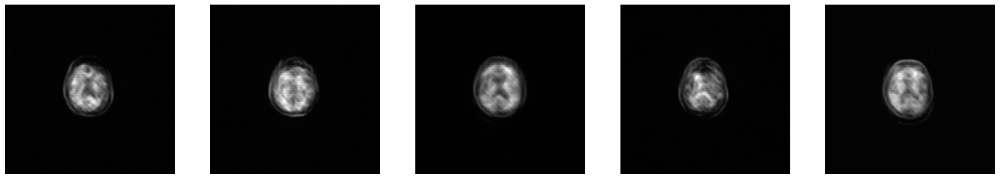

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>149, 0/61, g=0.80914432, d=1.51203918


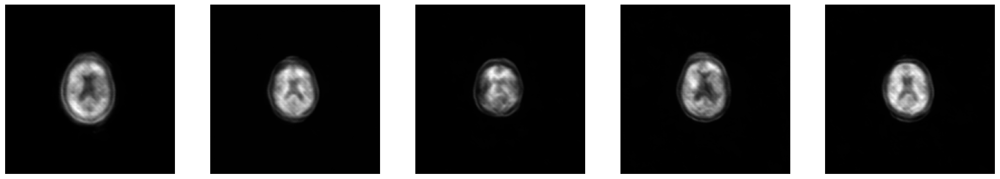

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>150, 0/61, g=1.01048875, d=1.20619214


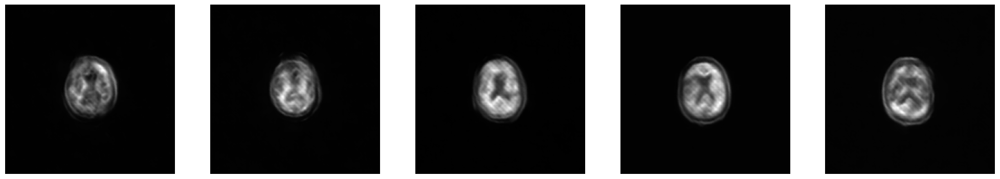

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>151, 0/61, g=0.99946344, d=1.35847473


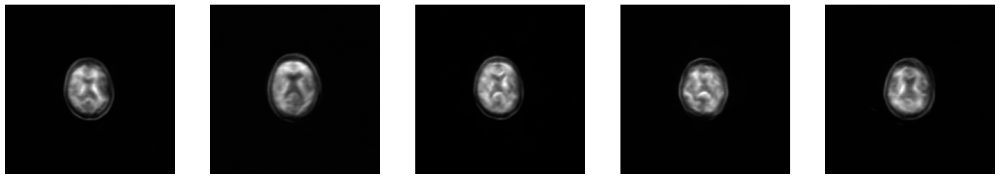

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>152, 0/61, g=1.39233685, d=1.41121459


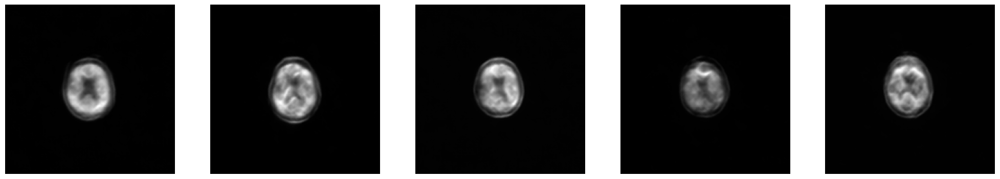

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>153, 0/61, g=0.95899200, d=1.24186635


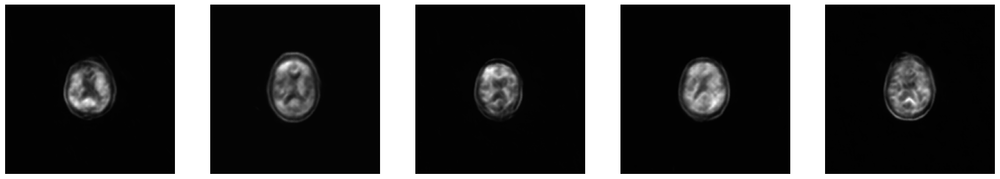

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>154, 0/61, g=0.78391826, d=1.18087006


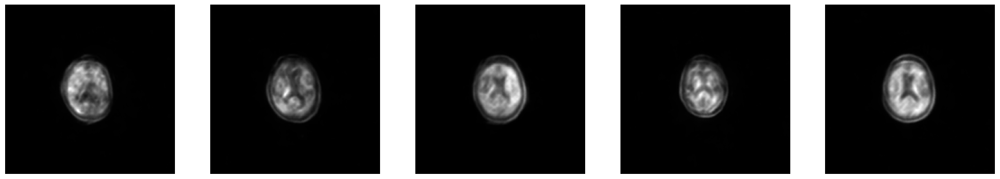

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>155, 0/61, g=1.03767371, d=1.46429205


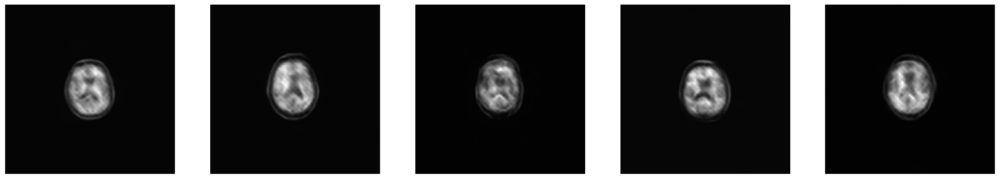

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>156, 0/61, g=0.71041614, d=1.35725164


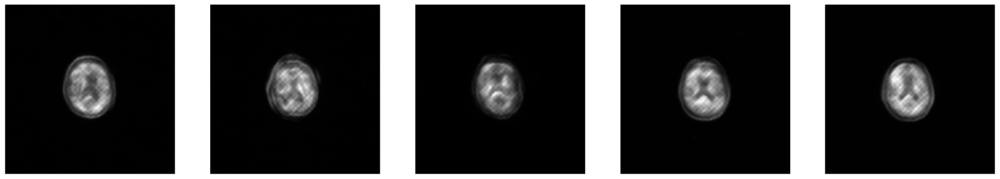

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>157, 0/61, g=1.18287396, d=1.28633857


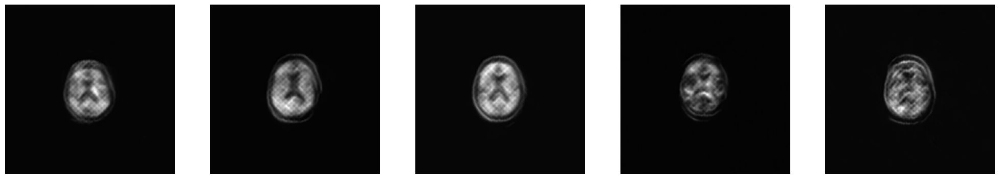

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>158, 0/61, g=0.73506916, d=1.31965578


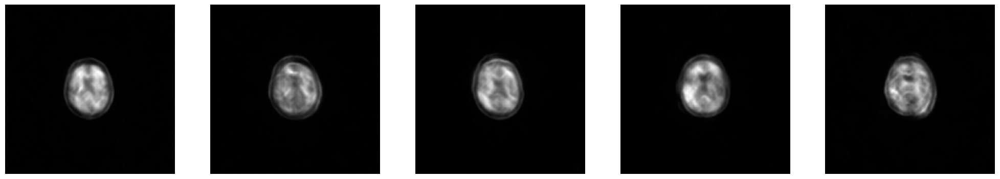

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>159, 0/61, g=0.87281579, d=0.94300067


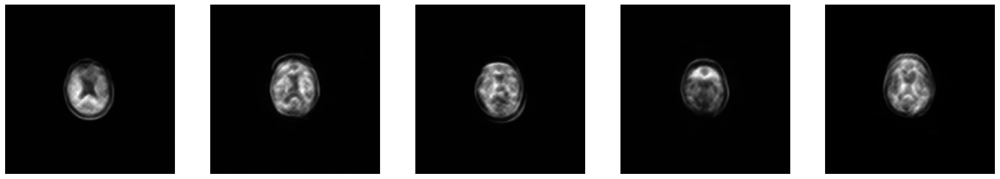

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>160, 0/61, g=1.05417943, d=1.23546052


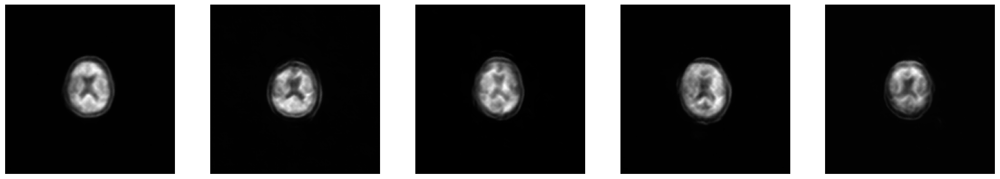

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>161, 0/61, g=1.37046170, d=1.76751637


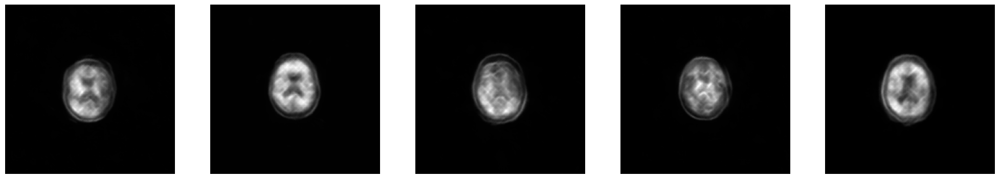

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>162, 0/61, g=0.89100397, d=1.34579587


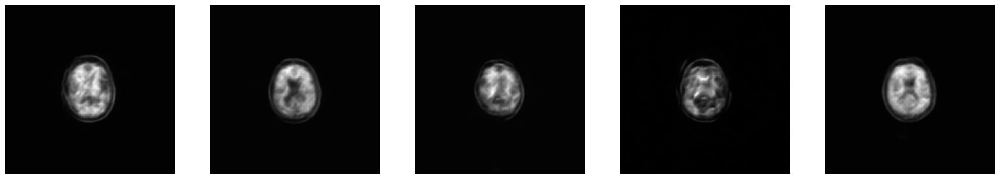

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>163, 0/61, g=0.58558381, d=1.35439587


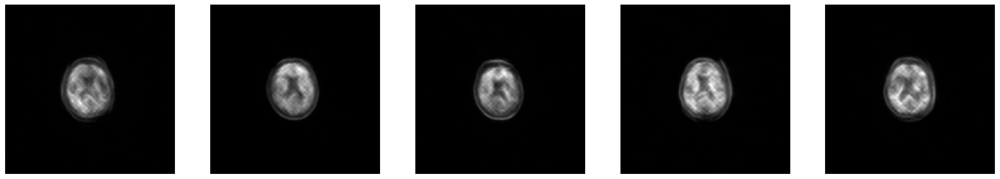

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>164, 0/61, g=0.89670181, d=1.02462578


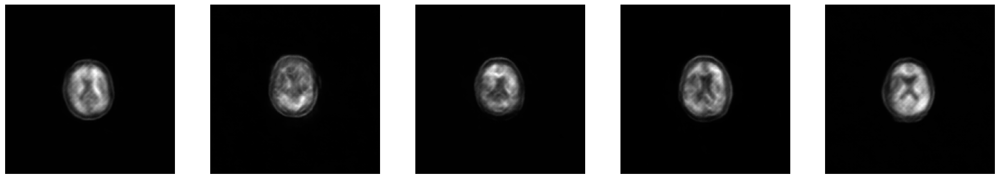

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>165, 0/61, g=0.85300463, d=1.35643280


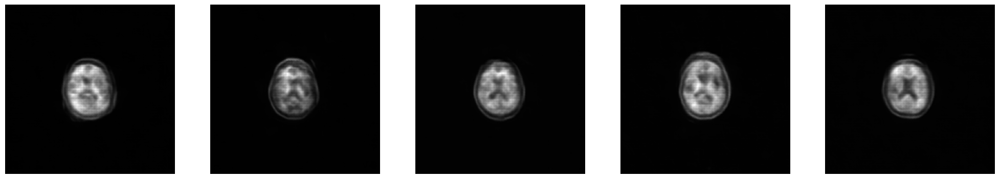

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>166, 0/61, g=0.69160336, d=1.62059891


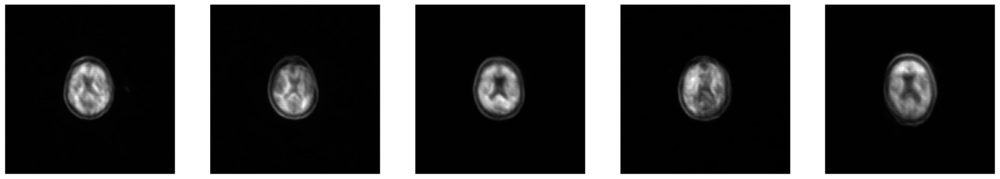

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>167, 0/61, g=0.57982498, d=1.37623835


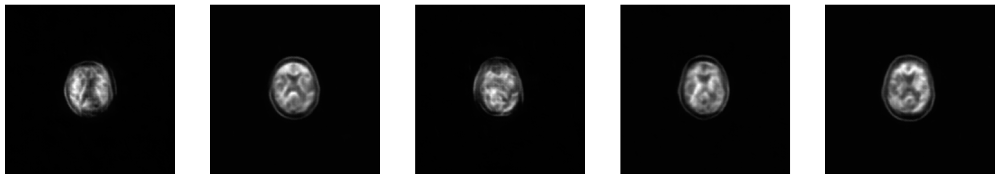

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>168, 0/61, g=0.75873834, d=1.45377922


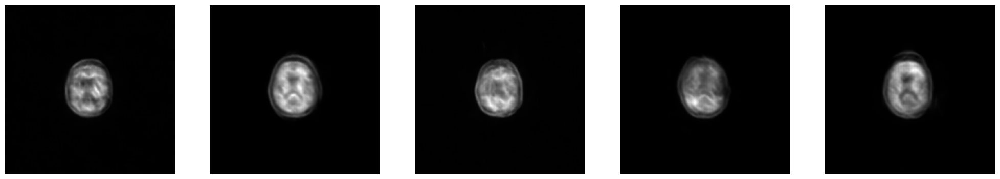

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>169, 0/61, g=0.90561408, d=1.53485239


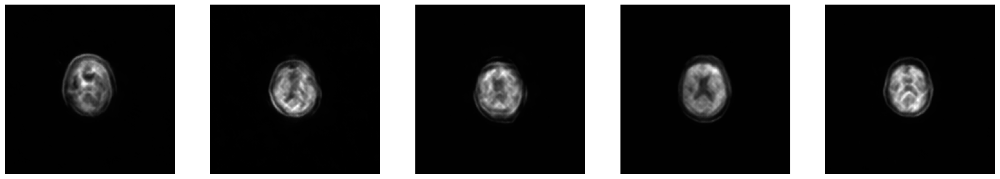

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>170, 0/61, g=0.98563766, d=1.32509971


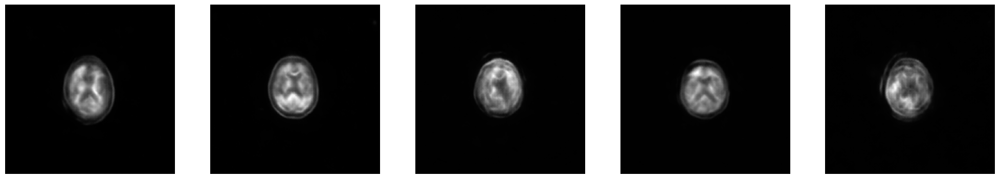

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>171, 0/61, g=1.00548530, d=1.37420154


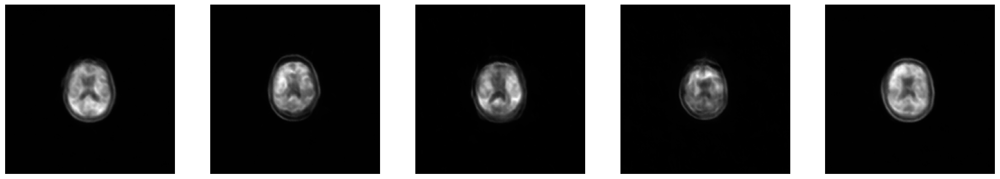

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>172, 0/61, g=1.10860562, d=1.31161296


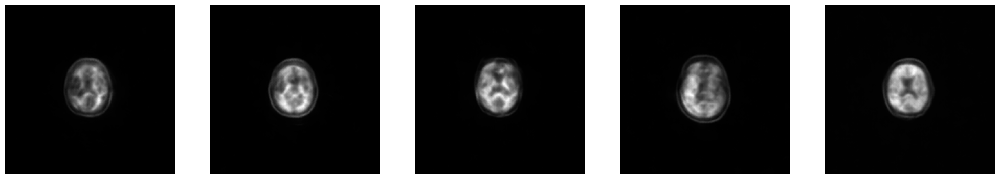

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>173, 0/61, g=0.66721547, d=1.74462986


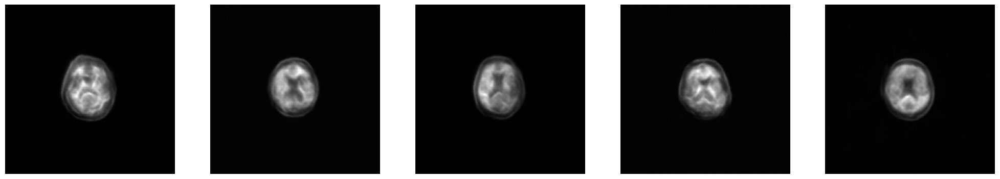

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>174, 0/61, g=1.16671419, d=1.25688577


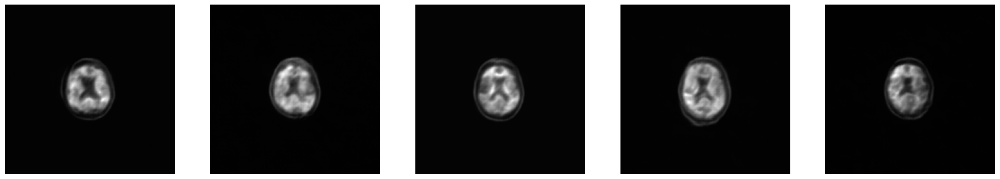

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>175, 0/61, g=0.86181688, d=1.45497811


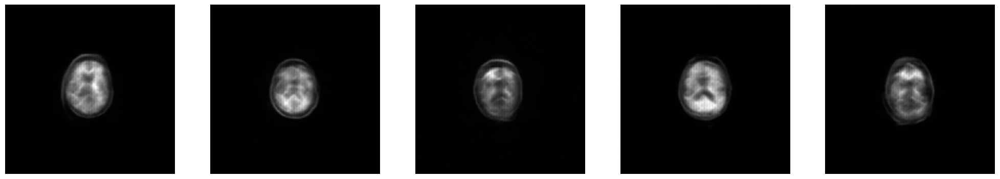

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>176, 0/61, g=0.84635413, d=1.09980583


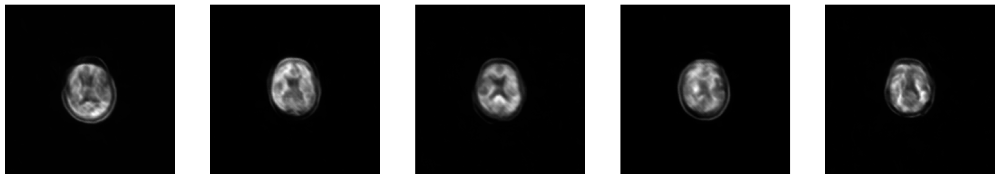

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>177, 0/61, g=1.26341236, d=1.36481011


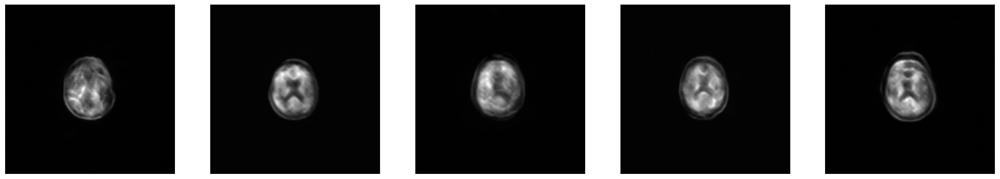

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>178, 0/61, g=0.86709392, d=1.28438950


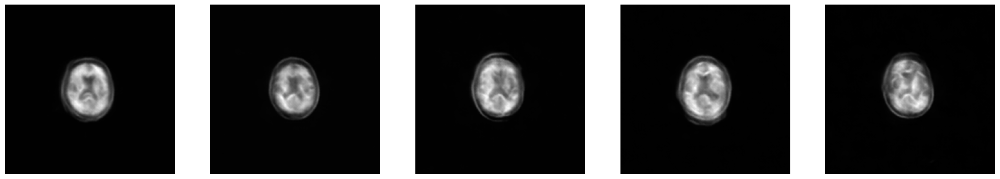

Batch Per Epoch : 25/61
Batch Per Epoch : 50/61
Batch Per Epoch : 0/61
>179, 0/61, g=0.89568299, d=1.62837970


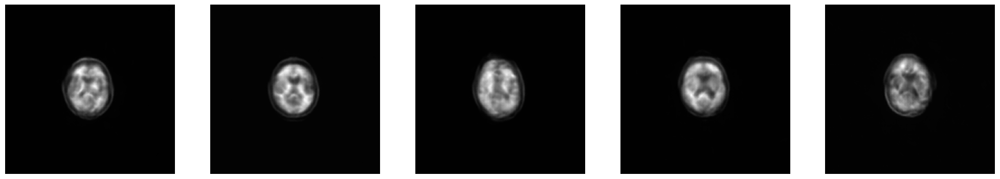

Batch Per Epoch : 25/61


In [ ]:
EPOCHS = 200

batch_per_epoch=np.round(training_images.shape[0]/batch_size)

def train(dataset, epochs):
    
    for epoch in range(epochs):
        count=0
        for image_batch in dataset:
          
            g_loss,d_loss=train_step(image_batch) 

            if (count) % 25 == 0:
     
               print('Batch Per Epoch : %d/%d' % (count ,batch_per_epoch))           

            if (count) % 350 == 0:

                print('>%d, %d/%d, g=%.8f, d=%.8f' % (epoch, count, batch_per_epoch, g_loss, d_loss))
                g_loss_history.append(g_loss)
                d_loss_history.append(d_loss) 
                
                noise = tf.random.normal([n_samples, latent_dim])
                x_fake = g_model(noise,training=False)

               
                
                pyplot.figure(figsize=(25,25))
                for i in range(n_samples):

                    pyplot.subplot(5, 5, 1 + i)
                    pyplot.axis('off')
                    pyplot.imshow(x_fake[i, :, :,0],cmap='gray')

                pyplot.show()
                pyplot.close()
            count=count+1

train(train_dataset, EPOCHS)


# **Display generated fake brain images**

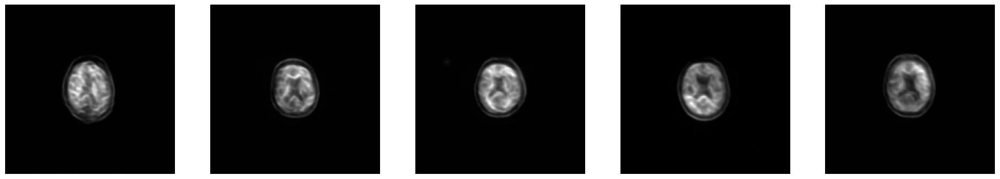

In [ ]:
noise = tf.random.normal([n_samples, latent_dim])
x_fake = g_model(noise,training=False)

pyplot.figure(figsize=(25,25))
for i in range(n_samples):
    pyplot.subplot(5, 5, 1 + i)
    pyplot.axis('off')
    pyplot.imshow(x_fake[i, :, :,0],cmap='gray')
    pyplot.savefig('0511 Epoch batch().png')
pyplot.show()
pyplot.close()
#filename = 'GAN_model_%03d.h5' 
#g_model.save(filename)


# **Model evaluation**

**Graph Generator and Discriminator Loss**

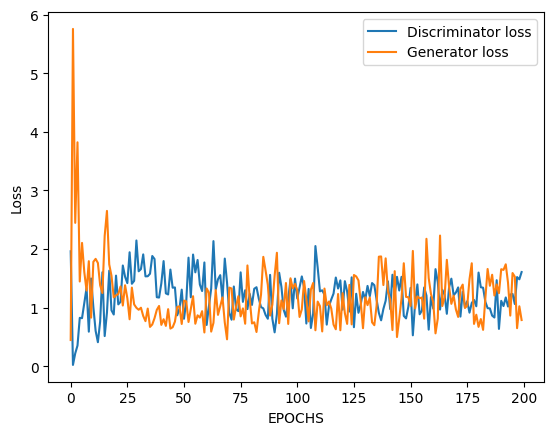

In [ ]:
plt.plot(d_loss_history, label='Discriminator loss')
plt.plot(g_loss_history, label='Generator loss')
plt.xlabel('EPOCHS')
plt.ylabel('Loss')
plt.legend()
plt.show()

**SSIM**

In [ ]:
whichfake=3
ssim_noise=[]

for i in range(training_images.shape[0]):
    ssim_noise.append( ssim(training_images[i,:,:,0], x_fake.numpy()[whichfake,:,:,0],data_range=np.max(x_fake.numpy()[whichfake,:,:,0]) - np.min(x_fake.numpy()[whichfake,:,:,0])))


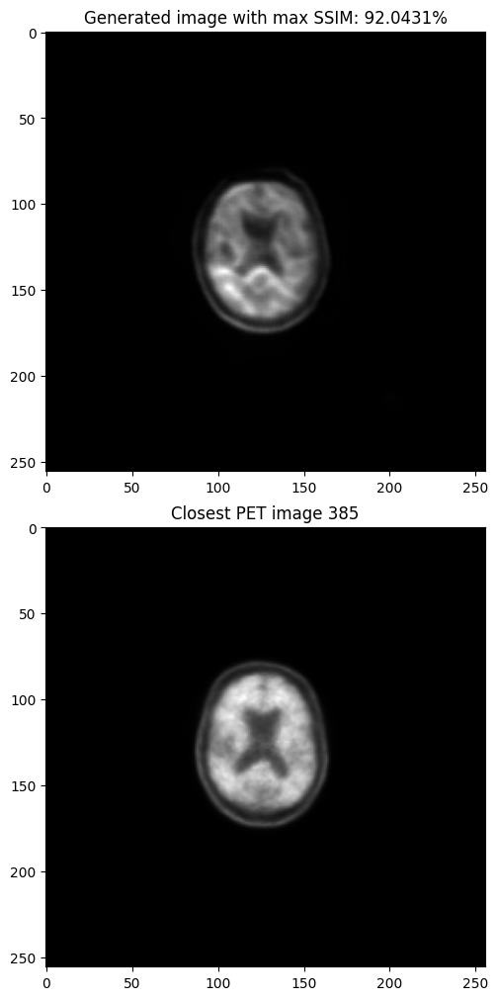

In [ ]:
fig, axs = pyplot.subplots(2, 1, constrained_layout=True,figsize=(10,10))
axs[0].imshow(x_fake[whichfake, :, :, 0],cmap="gray")
axs[0].set_title('Generated image with max SSIM: {:.4f}%'.format(np.max(ssim_noise)*100))

axs[1].imshow(training_images[ssim_noise.index(np.max(ssim_noise)), :, :, 0],cmap="gray")
axs[1].set_title('Closest PET image {:.0f}'.format(ssim_noise.index(np.max(ssim_noise))))

pyplot.show()